In [1]:
%matplotlib inline

In [2]:
from datetime import datetime
import os
from os.path import dirname, abspath, join
from os import getcwd
import sys

In [3]:
import random
import string
import pandas as pd
import numpy as np

In [4]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

In [5]:
import torch
import socket
from IPython.display import clear_output

In [6]:
# seed_arg = int(sys.argv[1])
# print ("\n\nSeed ARG: ",seed_arg)
seed_arg = 1

In [7]:
seedlist = np.array([161, 314, 228, 271828, 230, 4271031, 5526538, 6610165, 9849252, 34534, 73422, 8765])
seed = seedlist[seed_arg]
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

In [8]:
NAME       = 'B1_1_wakkanai'
MODELNAME  = NAME + '_' + str(seed) + '.pt'
print("\nMODEL : ", NAME)
print("SEED  : ",seed_arg)
print("HOST  : ",socket.gethostname())
print("START : ",datetime.now())


MODEL :  B1_1_wakkanai
SEED  :  1
HOST  :  7574709303cc
START :  2019-03-17 18:47:23.813898


In [9]:
class ENO(object):
    
    #no. of forecast types is 6 ranging from 0 to 5
  
    def __init__(self, location='tokyo', year=2010, shuffle=False, day_balance=False):
        self.location = location
        self.year = year
        self.day = None
        self.hr = None
        
        self.shuffle = shuffle
        self.day_balance = day_balance

        self.TIME_STEPS = None #no. of time steps in one episode
        self.NO_OF_DAYS = None #no. of days in one year
        
        self.NO_OF_DAYTYPE = 10 #no. of daytypes
        self.daycounter = 0 #to count number of days that have been passed
        
        self.sradiation = None #matrix with GSR for the entire year
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #array with forecast values for each day
        

        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
        self.sorted_days = [] #days sorted according to day type
        
        self.SMAX = 1000 # 1 Watt Solar Panel

    
    #function to get the solar data for the given location and year and prep it
    def get_data(self):
        #solar_data/CSV files contain the values of GSR (Global Solar Radiation in MegaJoules per meters squared per hour)
        #weather_data/CSV files contain the weather summary from 06:00 to 18:00 and 18:00 to 06:00+1
        location = self.location
        year = self.year

        THIS_DIR = getcwd()
        SDATA_DIR = abspath(join(THIS_DIR, 'solar_data'))  #abspath(join(THIS_DIR, '../../..', 'data'))
        
        sfile = SDATA_DIR + '/' + location +'/' + str(year) + '.csv'
        
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(sfile, skiprows=4, encoding='shift_jisx0213', usecols=[4])
      
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values

        #convert missing data in CSV files to zero
        solar_radiation[np.isnan(solar_radiation)] = 0

        #reshape solar_radiation into no_of_daysx24 array
        solar_radiation = solar_radiation.reshape(-1,24)

        if(self.shuffle): #if class instatiation calls for shuffling the day order. Required when learning
            np.random.shuffle(solar_radiation) 
        self.sradiation = solar_radiation
        
        #GSR values (in MJ/sq.mts per hour) need to be expressed in mW
        # Conversion is accomplished by 
        # solar_energy = GSR(in MJ/m2/hr) * 1e6 * size of solar cell * efficiency of solar cell /(60x60) *1000 (to express in mW)
        # the factor of 2 in the end is assuming two solar cells
        self.senergy = 2*self.sradiation * 1e6 * (55e-3 * 70e-3) * 0.15 * 1000/(60*60)

        return 0
    
    #function to map total day radiation into type of day ranging from 0 to 5
    #the classification into day types is quite arbitrary. There is no solid logic behind this type of classification.
    
    def get_day_state(self,tot_day_radiation):
        bin_edges = np.array([0, 3.5, 6.5, 9.0, 12.5, 15.5, 18.5, 22.0, 25, 28])
        for k in np.arange(1,bin_edges.size):
            if (bin_edges[k-1] < tot_day_radiation <= bin_edges[k]):
                day_state = k -1
            else:
                day_state = bin_edges.size - 1
        return int(day_state)
    
    def get_forecast(self):
        #create a perfect forecaster.
        tot_day_radiation = np.sum(self.sradiation, axis=1) #contains total solar radiation for each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_radiation)
        
        #sort days depending on the type of day and shuffle them; maybe required when learning
        for fcast in range(0,6):
            fcast_days = ([i for i,x in enumerate(self.fforecast) if x == fcast])
            np.random.shuffle(fcast_days)
            self.sorted_days.append(fcast_days)
        return 0
    
    def reset(self,day=0): #it is possible to reset to the beginning of a certain day
        
        self.get_data() #first get data for the given year
        self.get_forecast() #calculate the forecast
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        self.day = day
        self.hr = 0
        
        self.henergy = self.senergy[self.day][self.hr]
        self.fcast = self.fforecast[self.day]
        
        end_of_day = False
        end_of_year = False
        return [self.henergy, self.fcast, end_of_day, end_of_year]

    
    def step(self):
        end_of_day = False
        end_of_year = False
        if not(self.day_balance): #if daytype balance is not required
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr] 
                self.fcast = self.fforecast[self.day]
            else:
                if(self.day < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.hr = 0
                    self.day += 1
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else:
                    end_of_day = True
                    end_of_year = True
                    
        else: #when training, we want all daytypes to be equally represented for robust policy
              #obviously, the days are going to be in random order
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr]
                self.fcast = self.fforecast[self.day]
            else:
                if(self.daycounter < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.daycounter += 1
                    self.hr = 0
                    daytype = random.choice(np.arange(0,self.NO_OF_DAYTYPE)) #choose random daytype
                    self.day = np.random.choice(self.sorted_days[daytype]) #choose random day from that daytype
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else: 
                    end_of_day = True
                    end_of_year = True
                    self.daycounter = 0
        
        
        return [self.henergy, self.fcast, end_of_day, end_of_year]

In [10]:
class CAPM (object):
    def __init__(self,location='tokyo', year=2010, shuffle=False, trainmode=False):

        #all energy values i.e. BMIN, BMAX, BOPT, HMAX are in mWhr. Assuming one timestep is one hour
        
        self.BMIN = 0.0                #Minimum battery level that is tolerated. Maybe non-zero also
        self.BMAX = 10000.0            #Max Battery Level. May not necessarily be equal to total batter capacity [3.6V x 2500mAh]
        self.BOPT = 0.5 * self.BMAX    #Optimal Battery Level. Assuming 50% of battery is the optimum
        self.BLIM_LO = 0.15*self.BMAX
        self.BLIM_HI = 0.95*self.BMAX
        self.BSAFE_LO = 0.35*self.BMAX
        self.BSAFE_HI = 0.65*self.BMAX
        
        self.ENP_MARGIN = 0.3*self.BMAX

        
        self.HMIN = 0      #Minimum energy that can be harvested by the solar panel.
        self.HMAX = None   #Maximum energy that can be harvested by the solar panel. [500mW]
        
        self.DMAX = 500      #Maximum energy that can be consumed by the node in one time step. [~ 3.6V x 135mA]
        self.N_ACTIONS = 10  #No. of different duty cycles possible
        self.DMIN = self.DMAX/self.N_ACTIONS #Minimum energy that can be consumed by the node in one time step. [~ 3.6V x 15mA]
        
        self.binit = None     #battery at the beginning of day
        self.btrack = []      #track the mean battery level for each day
        self.atrack = []      #track the duty cycles for each day
        self.htrack = []      #track the harvested for each day
        self.batt = None      #battery variable
        self.enp = None       #enp at end of hr
        self.henergy = None   #harvested energy variable
        self.fcast = None     #forecast variable
        
        self.MUBATT = 0.6
        self.SDBATT = 0.02
        
        self.MUHENERGY = 0.5
        self.SDHENERGY = 0.2
        
        self.MUENP = 0
        self.SDENP = 0.02
        
        self.location  = location
        self.year      = year
        self.shuffle   = shuffle
        self.trainmode = trainmode
        self.eno       = None
        
        self.day_violation_flag = False
        self.violation_flag     = False
        self.violation_counter  = 0
        
        self.batt_violations    = 0

        self.NO_OF_DAYTYPE      = 10 #no. of daytypes
 
    def reset(self,day=0,batt=-1):
        henergy, fcast, day_end, year_end = self.eno.reset(day) #reset the eno environment
        self.violation_flag = False
        self.violation_counter = 0
        self.batt_violations = 0
        
        if(batt == -1):
            self.batt = self.BOPT
        else:
            self.batt = batt
            
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.binit = self.batt
        self.btrack = np.append(self.btrack, self.batt) #track battery levels

        self.enp = self.BOPT - self.batt
#         self.enp = self.binit - self.batt #enp is calculated
        self.henergy = np.clip(henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
        self.fcast = fcast
        
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        reward = 0
        
        return [c_state, reward, day_end, year_end]
    
    def getstate(self): #query the present state of the system
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        return c_state
        
    
    #reward function
    def rewardfn(self):
        violation_penalty = 0
        bmean = self.btrack.mean()
        bdev = self.BOPT - bmean
        if np.abs(bdev) > (self.BOPT - self.ENP_MARGIN):
            reward = 2-np.abs(bdev)/self.BMAX*10
        else:
            reward = 2
#         reward = 2 - 20*np.abs(bdev)/self.BMAX
        if(self.day_violation_flag):
            violation_penalty += 3    #penalty for violating battery limits anytime during the day
        return (reward - violation_penalty)
    
    
    
    def step(self, action):
        day_end = False
        year_end = False
        self.violation_flag = False
        reward = 0
        self.atrack = np.append(self.atrack, action+1) #track duty cycles
        self.htrack = np.append(self.htrack, self.henergy)

#         action_var = np.abs(np.mean(self.atrack) - action)/9 #can vary from 0 to 1
#         reward += 0.25*(0.5 - action_var ) #reward penalizing high duty cycle variance [-0.5 to 0.5]*0.25
      
        action = np.clip(action, 0, self.N_ACTIONS-1) #action values range from (0 to N_ACTIONS-1)
        e_consumed = (action+1)*self.DMAX/self.N_ACTIONS   #energy consumed by the node
        
        
        self.batt += (self.henergy - e_consumed)
        if(self.batt <= self.BMIN or self.batt >= self.BMAX ):
                self.batt_violations += 1
        
        if(self.batt < self.BLIM_LO or self.batt > self.BLIM_HI ):
            self.violation_flag = True #penalty for violating battery limits everytime it happens
#             reward -= 2
#             if(self.batt < self.BLIM_LO): #battery depletion is more fatal than battery overflow
#                 reward -= 2

        if(self.violation_flag):
            if(self.day_violation_flag == False): #penalty for violating battery limits anytime during the day - triggers once everyday
                self.violation_counter += 1
                self.day_violation_flag = True
                
        #calculate ENP before clipping
        self.enp = self.BOPT - self.batt
        
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX) #clip battery values within permitted level
        self.btrack = np.append(self.btrack, self.batt) #track battery levels
        
        
        #proceed to the next time step
       
        self.henergy, self.fcast, day_end, year_end = self.eno.step()
        self.henergy = np.clip(self.henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
                        
        if(day_end): #if eno object flags that the day has ended then give reward
            reward += self.rewardfn()
            if (self.trainmode): #reset battery to optimal level if limits are exceeded when training
#                 self.batt = np.random.uniform(self.DMAX*self.eno.TIME_STEPS/self.BMAX,0.8)*self.BMAX
#                 if (self.violation_flag):
                if np.random.uniform() < HELP : #occasionaly reset the battery
                    self.batt = self.BOPT  
            
            self.day_violation_flag = False
            self.binit = self.batt #this will be the new initial battery level for next day
            self.btrack = [] #clear battery tracker
            self.atrack = [] #clear duty cycle tracker
            self.htrack = [] #clear henergy tracker
   
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states
        
        return [c_state, reward, day_end, year_end]

In [11]:
# Hyper Parameters
BATCH_SIZE          = 12
WT_DECAY            = None
LR                  = 1e-4          # learning rate
EPSILON             = 0.9           # greedy policy
GAMMA               = 0.9           # reward discount
LAMBDA              = 0.95          # parameter decay
TARGET_REPLACE_ITER = 24*7*4*18     # target update frequency
MEMORY_CAPACITY     = 24*7*4*12*3   # store upto six month worth of memory   

N_ACTIONS           = 10            # no. of duty cycles (0,1,2,3,4)
N_STATES            = 4             # number of state space parameter [batt, enp, henergy, fcast]

HIDDEN_LAYER        = 50            # width of NN
NO_OF_ITERATIONS    = 100
GPU                 = False         # device
HELP                = 0.05

In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

#Class definitions for NN model and learning algorithm
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        self.fc1 = nn.Linear(N_STATES, HIDDEN_LAYER)
        nn.init.kaiming_uniform_(self.fc1.weight)
        
#         self.fc2 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         nn.init.kaiming_uniform_(self.fc2.weight)
        
#         self.fc3 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         nn.init.kaiming_uniform_(self.fc3.weight)

        self.fc_out = nn.Linear(HIDDEN_LAYER, N_ACTIONS)
        nn.init.xavier_uniform_(self.fc_out.weight) 
    
    def forward(self, x):
        x = self.fc1(x)
        x = F.relu(x)
#         x = F.leaky_relu(x)
#         x = self.fc2(x)
#         x = F.relu(x)
#         x = self.fc3(x)
#         x = F.relu(x)
        x = self.fc_out(x)
        return x
    
class DQN(object):
    def __init__(self):
        if(GPU): 
            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        else:
            device = torch.device('cpu')
        self.eval_net, self.target_net = Net(), Net()
        self.eval_net.to(device)
        self.target_net.to(device)
        self.device = device
#         print("Neural net")
#         print(self.eval_net)
        self.learn_step_counter = 0                                     # for target updating
        self.memory_counter = 0                                         # for storing memory
        self.memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR)
#         self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR, weight_decay=WT_DECAY)
#         self.loss_func = nn.SmoothL1Loss()
        self.loss_func = nn.MSELoss()
        self.nettoggle = False

    def choose_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        actions_value = self.eval_net.forward(x)
        actions_value = actions_value.to(torch.device("cpu"))
        action = torch.max(actions_value, 1)[1].data.numpy()
        action = action[0] # return the argmax index
        if np.random.uniform() > EPSILON:   # greedy
            action += np.random.randint(-3, 3)
            action = int(np.clip(action, 0, N_ACTIONS-1))
        return action
    
    def choose_greedy_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        # input only one sample
        if True:   # greedy
            actions_value = self.eval_net.forward(x)
            actions_value = actions_value.to(torch.device("cpu"))
            action = torch.max(actions_value, 1)[1].data.numpy()
            action = action[0] # return the argmax index
        return action

    def store_transition(self, s, a, r, s_):
        transition = np.hstack((s, [a, r], s_))
        # replace the old memory with new memory
        index = self.memory_counter % MEMORY_CAPACITY
        self.memory[index, :] = transition
        self.memory_counter += 1
    
    def store_day_transition(self, transition_rec):
        data = transition_rec
        index = self.memory_counter % MEMORY_CAPACITY
        self.memory= np.insert(self.memory, index, data,0)
        self.memory_counter += transition_rec.shape[0]

    def learn(self):
        # target parameter update
        if self.learn_step_counter % TARGET_REPLACE_ITER == 0:
            self.target_net.load_state_dict(self.eval_net.state_dict())
            self.nettoggle = not self.nettoggle
        self.learn_step_counter += 1

        # sample batch transitions
        sample_index = np.random.choice(MEMORY_CAPACITY, BATCH_SIZE)
        b_memory = self.memory[sample_index, :]
        b_s = torch.FloatTensor(b_memory[:, :N_STATES])
        b_a = torch.LongTensor(b_memory[:, N_STATES:N_STATES+1].astype(int))
        b_r = torch.FloatTensor(b_memory[:, N_STATES+1:N_STATES+2])
        b_s_ = torch.FloatTensor(b_memory[:, -N_STATES:])
        
        b_s = b_s.to(self.device)
        b_a = b_a.to(self.device)
        b_r = b_r.to(self.device)
        b_s_ = b_s_.to(self.device)

        # q_eval w.r.t the action in experience
        q_eval = self.eval_net(b_s).gather(1, b_a)  # shape (batch, 1)
        q_next = self.target_net(b_s_).detach()     # detach from graph, don't backpropagate
        q_target = b_r + GAMMA * q_next.max(1)[0].view(BATCH_SIZE, 1)   # shape (batch, 1)
        loss = self.loss_func(q_eval, q_target)

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

In [13]:
def stdize(s):
    MU_BATT = 0.5
    SD_BATT = 0.15
    
    MU_ENP = 0
    SD_ENP = 0.15
    
    MU_HENERGY = 0.35
    SD_HENERGY = 0.25
    
    MU_FCAST = 0.42
    SD_FCAST = 0.27
    
    norm_batt, norm_enp, norm_henergy, norm_fcast = s
    
    std_batt    = (norm_batt    - MU_BATT    )/SD_BATT
    std_enp     = (norm_enp     - MU_ENP     )/SD_ENP
    std_henergy = (norm_henergy - MU_HENERGY )/SD_HENERGY
    std_fcast   = (norm_fcast   - MU_FCAST   )/SD_FCAST

    return [std_batt, std_enp, std_henergy, std_fcast]


In [14]:
#CONSTANTS
LOCATION = 'tokyo'
YEAR = 2010
capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
print("BMIN       = ", capm.BMIN)
print("BMAX       = ", capm.BMAX)
print("BOPT       = ", capm.BOPT)
print("BLIM_LO    = ", capm.BLIM_LO)
print("BLIM_HI    = ", capm.BLIM_HI)
print("BSAFE_LO   = ", capm.BSAFE_LO)
print("BSAFE_HI   = ", capm.BSAFE_HI)
print("ENP_MARGIN = ", capm.ENP_MARGIN)

BMIN       =  0.0
BMAX       =  10000.0
BOPT       =  5000.0
BLIM_LO    =  1500.0
BLIM_HI    =  9500.0
BSAFE_LO   =  3500.0
BSAFE_HI   =  6500.0
ENP_MARGIN =  3000.0


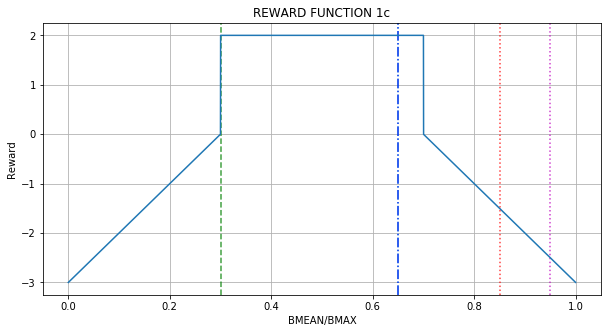

RF_1c(0)            =  -3.00
RF_1c(ENP_MARGIN/4) =  -3.00
RF_1c(ENP_MARGIN/2) =  -3.00
RF_1c(ENP_MARGIN)   =  -3.00

RF_1c(BMAX/2) =  -3.00
RF_1c(BMAX)   =  -3.00



In [15]:
#PLOT REWARD FUNCTIONS
x = np.arange(0,capm.BMAX)
y = [capm.rewardfn() for capm.btrack in x]

fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot(111)
ax.set_title('REWARD FUNCTION 1c')
ax.set_xlabel('BMEAN/BMAX')
ax.set_ylabel('Reward')
ax.axvline((capm.ENP_MARGIN)/capm.BMAX, color='g',alpha=0.75, linestyle='--')
ax.axvline(1-(capm.BSAFE_LO)/capm.BMAX, color='c',alpha=0.75, linestyle='-.')
ax.axvline(  (capm.BSAFE_HI)/capm.BMAX, color='b',alpha=0.75, linestyle="-.")
ax.axvline(1- (capm.BLIM_LO)/capm.BMAX, color='r',alpha=0.75, linestyle=':')
ax.axvline(   (capm.BLIM_HI)/capm.BMAX, color='m',alpha=0.75, linestyle=":")
ax.plot(x/capm.BMAX,y)
ax.grid(True)
plt.show()

capm.enp = 0;            print("RF_1c(0)            = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/4; print("RF_1c(ENP_MARGIN/4) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/2; print("RF_1c(ENP_MARGIN/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN;   print("RF_1c(ENP_MARGIN)   = {:6.2f}".format(capm.rewardfn()) )
print("");
capm.enp = capm.BMAX/2; print("RF_1c(BMAX/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.BMAX;   print("RF_1c(BMAX)   = {:6.2f}".format(capm.rewardfn()) )
print("");

In [16]:
#TRAINING STARTS
tic = datetime.now()

Device:  cpu

Iteration 0:  WAKKANAI, 2003 
EPSILON = 5.000e-01
LR = 3.392e-05
Average Terminal Reward  = -2.990
Day Violations           =    232
Battery Limit Violations =   1627
Action MEAN              =  3.096
Action STD DEV           =  1.976


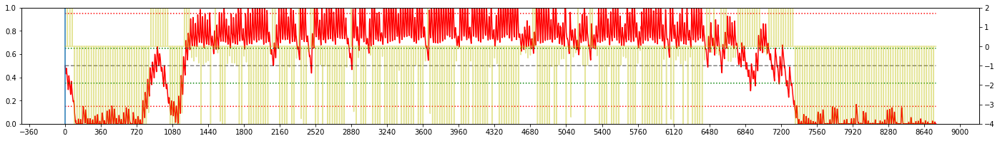


Iteration 1:  WAKKANAI, 2007 
EPSILON = 5.000e-01
LR = 4.174e-05
Average Terminal Reward  = -2.840
Day Violations           =    222
Battery Limit Violations =   1542
Action MEAN              =  2.989
Action STD DEV           =  1.904


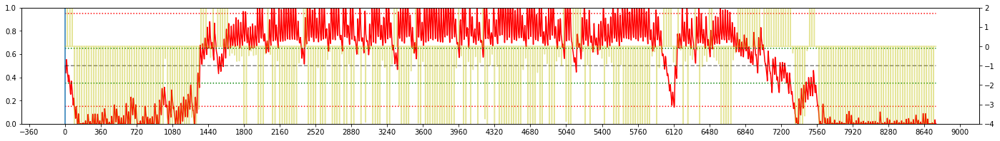


Iteration 2:  WAKKANAI, 2001 
EPSILON = 5.000e-01
LR = 5.000e-05
Average Terminal Reward  = -3.117
Day Violations           =    240
Battery Limit Violations =   1913
Action MEAN              =  3.001
Action STD DEV           =  1.845


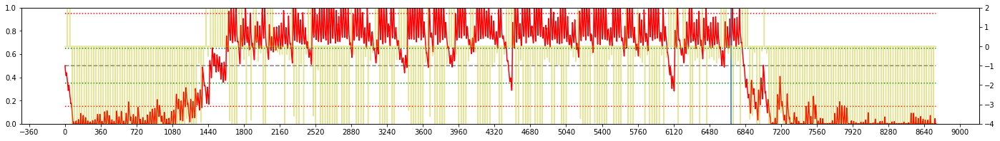


Iteration 3:  WAKKANAI, 2002 
EPSILON = 5.000e-01
LR = 5.826e-05
Average Terminal Reward  = -4.542
Day Violations           =    310
Battery Limit Violations =   3122
Action MEAN              =  2.972
Action STD DEV           =  1.986


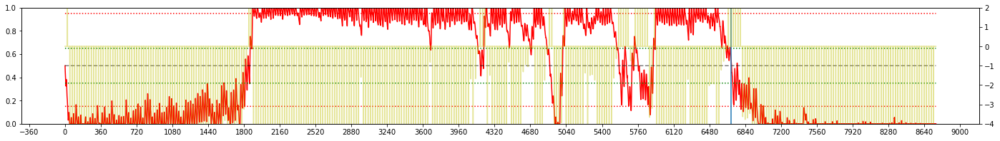


Iteration 4:  WAKKANAI, 2000 
EPSILON = 5.001e-01
LR = 6.608e-05
Average Terminal Reward  = -4.222
Day Violations           =    283
Battery Limit Violations =   3106
Action MEAN              =  3.636
Action STD DEV           =  2.293


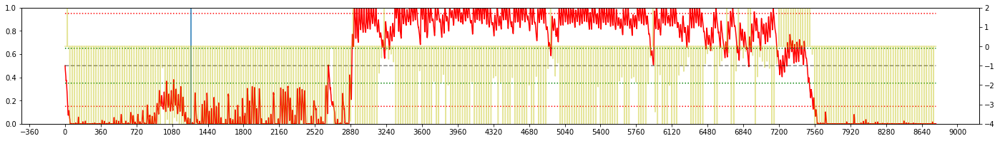


Iteration 5:  WAKKANAI, 2004 
EPSILON = 5.001e-01
LR = 7.311e-05
Average Terminal Reward  = -3.958
Day Violations           =    272
Battery Limit Violations =   2949
Action MEAN              =  3.821
Action STD DEV           =  2.613


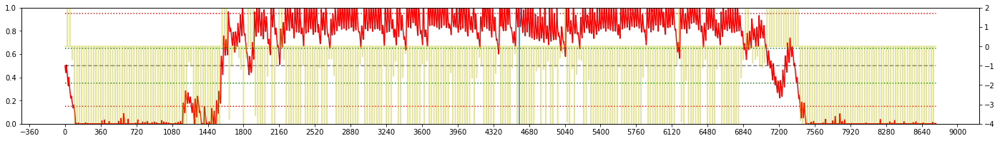


Iteration 6:  WAKKANAI, 2003 
EPSILON = 5.001e-01
LR = 7.914e-05
Average Terminal Reward  = -4.094
Day Violations           =    282
Battery Limit Violations =   2728
Action MEAN              =  3.866
Action STD DEV           =  2.672


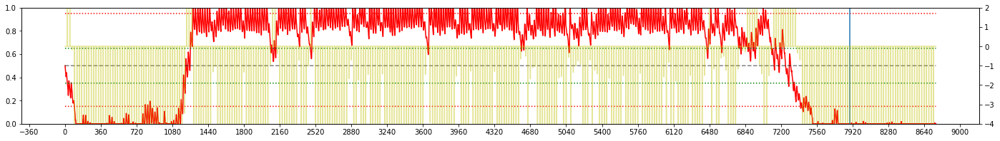


Iteration 7:  WAKKANAI, 2006 
EPSILON = 5.001e-01
LR = 8.411e-05
Average Terminal Reward  = -3.684
Day Violations           =    256
Battery Limit Violations =   2219
Action MEAN              =  3.493
Action STD DEV           =  2.571


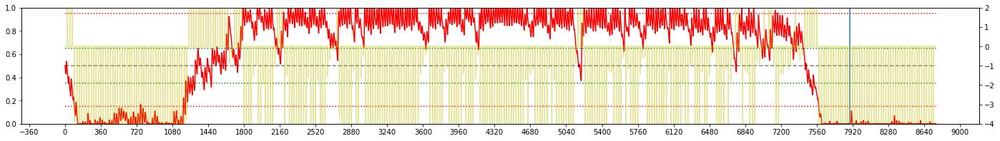


Iteration 8:  WAKKANAI, 2003 
EPSILON = 5.001e-01
LR = 8.808e-05
Average Terminal Reward  = -3.492
Day Violations           =    251
Battery Limit Violations =   2082
Action MEAN              =  3.630
Action STD DEV           =  2.579


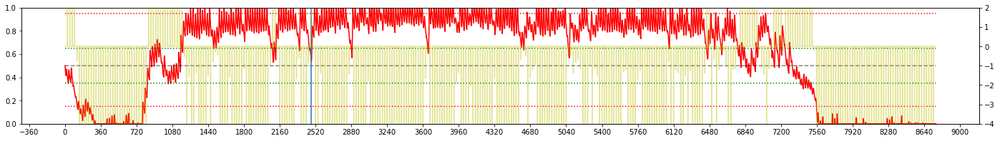


Iteration 9:  WAKKANAI, 2006 
EPSILON = 5.001e-01
LR = 9.116e-05
Average Terminal Reward  = -3.252
Day Violations           =    228
Battery Limit Violations =   2074
Action MEAN              =  3.812
Action STD DEV           =  2.664


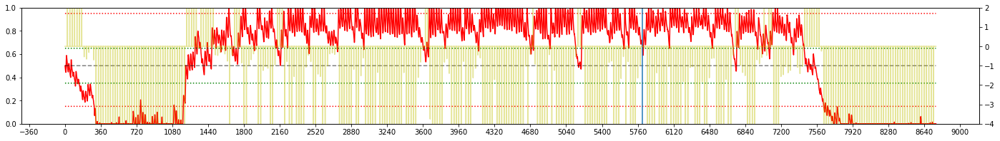


Iteration 10:  WAKKANAI, 2008 
EPSILON = 5.002e-01
LR = 9.350e-05
Average Terminal Reward  = -2.848
Day Violations           =    210
Battery Limit Violations =   1840
Action MEAN              =  3.922
Action STD DEV           =  2.834


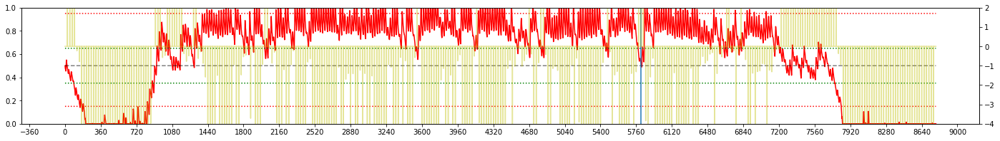


Iteration 11:  WAKKANAI, 2007 
EPSILON = 5.002e-01
LR = 9.526e-05
Average Terminal Reward  = -2.299
Day Violations           =    180
Battery Limit Violations =   1503
Action MEAN              =  3.839
Action STD DEV           =  2.828


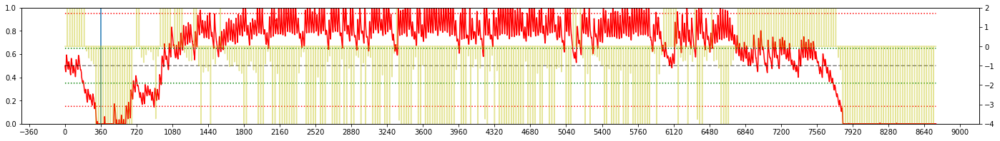


Iteration 12:  WAKKANAI, 2000 
EPSILON = 5.003e-01
LR = 9.656e-05
Average Terminal Reward  = -1.518
Day Violations           =    155
Battery Limit Violations =   1530
Action MEAN              =  3.593
Action STD DEV           =  2.356


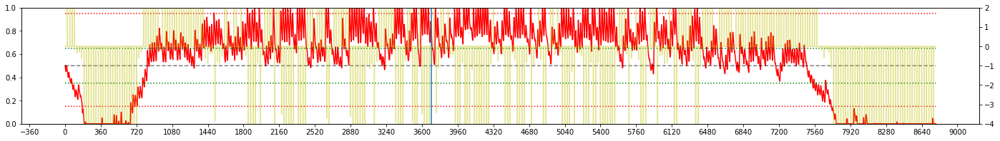


Iteration 13:  WAKKANAI, 2002 
EPSILON = 5.003e-01
LR = 9.751e-05
Average Terminal Reward  = -1.456
Day Violations           =    163
Battery Limit Violations =   1684
Action MEAN              =  3.752
Action STD DEV           =  2.272


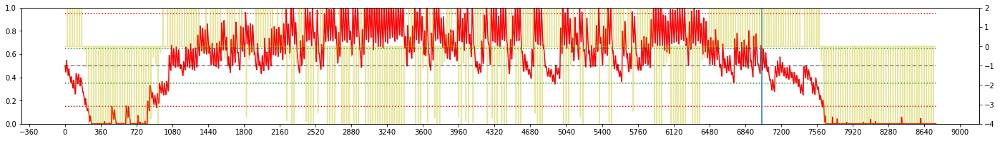


Iteration 14:  WAKKANAI, 2002 
EPSILON = 5.004e-01
LR = 9.820e-05
Average Terminal Reward  = -1.163
Day Violations           =    149
Battery Limit Violations =   1766
Action MEAN              =  3.945
Action STD DEV           =  2.355


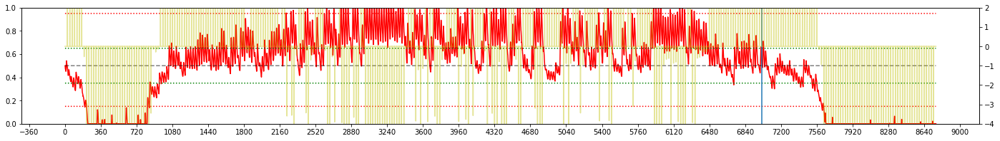


Iteration 15:  WAKKANAI, 2001 
EPSILON = 5.005e-01
LR = 9.870e-05
Average Terminal Reward  = -1.388
Day Violations           =    166
Battery Limit Violations =   1916
Action MEAN              =  4.422
Action STD DEV           =  2.952


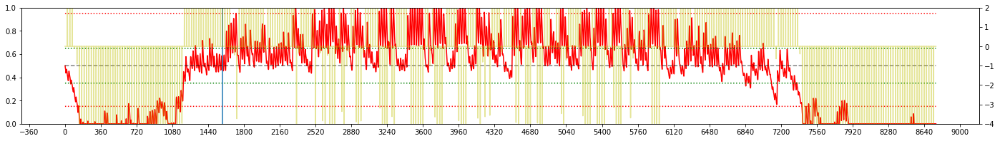


Iteration 16:  WAKKANAI, 2003 
EPSILON = 5.006e-01
LR = 9.907e-05
Average Terminal Reward  = -0.793
Day Violations           =    133
Battery Limit Violations =   1573
Action MEAN              =  4.452
Action STD DEV           =  2.774


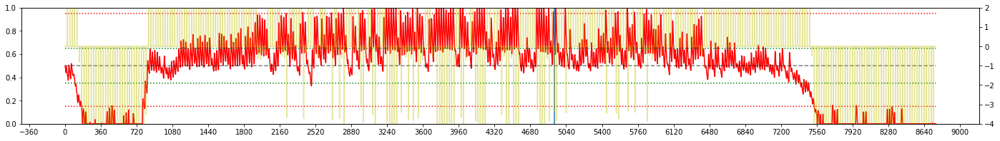


Iteration 17:  WAKKANAI, 2000 
EPSILON = 5.007e-01
LR = 9.933e-05
Average Terminal Reward  = -0.371
Day Violations           =    112
Battery Limit Violations =   1541
Action MEAN              =  4.185
Action STD DEV           =  2.946


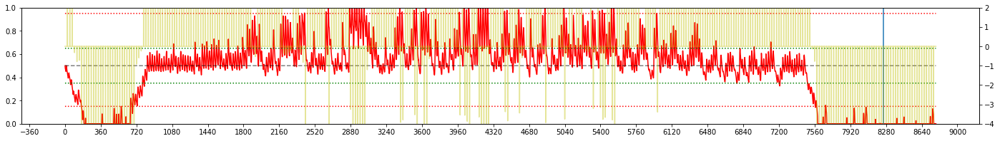


Iteration 18:  WAKKANAI, 2003 
EPSILON = 5.008e-01
LR = 9.952e-05
Average Terminal Reward  = -0.557
Day Violations           =    120
Battery Limit Violations =   1488
Action MEAN              =  4.362
Action STD DEV           =  2.755


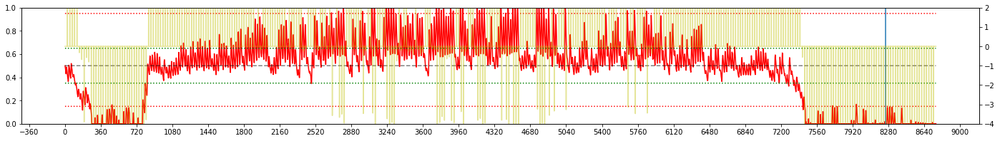


Iteration 19:  WAKKANAI, 2009 
EPSILON = 5.010e-01
LR = 9.966e-05
Average Terminal Reward  = -0.788
Day Violations           =    135
Battery Limit Violations =   1810
Action MEAN              =  4.207
Action STD DEV           =  2.733


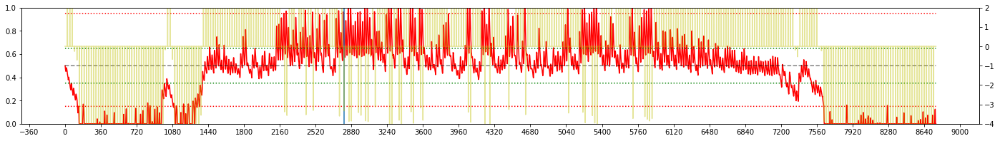


Iteration 20:  WAKKANAI, 2004 
EPSILON = 5.012e-01
LR = 9.975e-05
Average Terminal Reward  = -0.242
Day Violations           =    107
Battery Limit Violations =   1523
Action MEAN              =  4.296
Action STD DEV           =  3.073


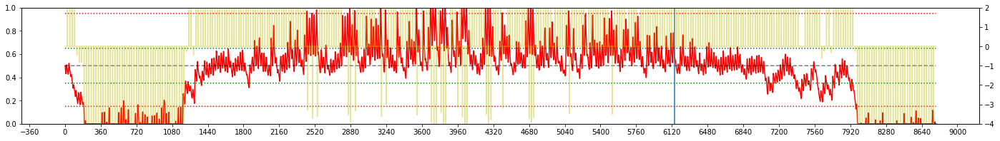


Iteration 21:  WAKKANAI, 2000 
EPSILON = 5.015e-01
LR = 9.982e-05
Average Terminal Reward  =  0.064
Day Violations           =     88
Battery Limit Violations =   1512
Action MEAN              =  4.102
Action STD DEV           =  2.993


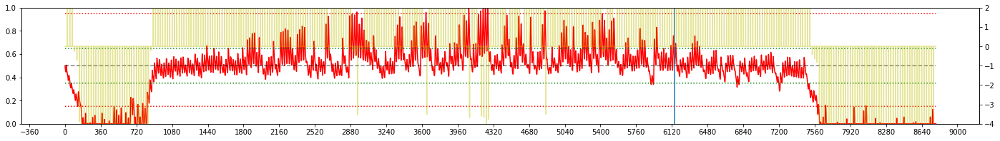


Iteration 22:  WAKKANAI, 2003 
EPSILON = 5.018e-01
LR = 9.987e-05
Average Terminal Reward  =  0.180
Day Violations           =     84
Battery Limit Violations =   1436
Action MEAN              =  4.234
Action STD DEV           =  2.896


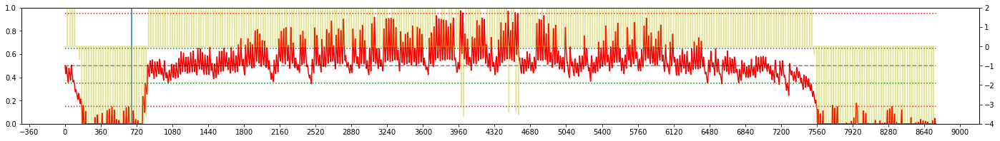


Iteration 23:  WAKKANAI, 2002 
EPSILON = 5.022e-01
LR = 9.991e-05
Average Terminal Reward  =  0.151
Day Violations           =     83
Battery Limit Violations =   1411
Action MEAN              =  3.938
Action STD DEV           =  2.859


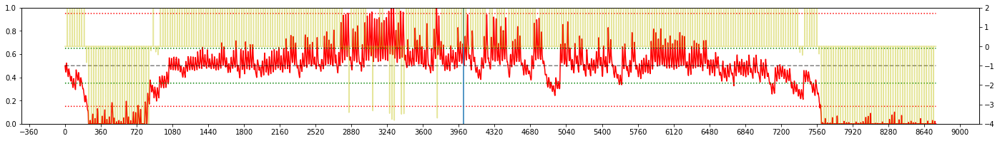


Iteration 24:  WAKKANAI, 2005 
EPSILON = 5.027e-01
LR = 9.993e-05
Average Terminal Reward  =  0.176
Day Violations           =     84
Battery Limit Violations =   1150
Action MEAN              =  3.763
Action STD DEV           =  2.912


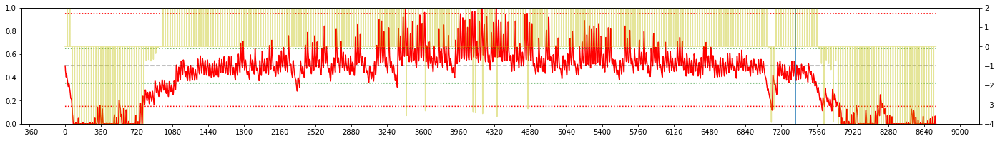


Iteration 25:  WAKKANAI, 2005 
EPSILON = 5.033e-01
LR = 9.995e-05
Average Terminal Reward  =  0.097
Day Violations           =     88
Battery Limit Violations =   1295
Action MEAN              =  3.817
Action STD DEV           =  2.853


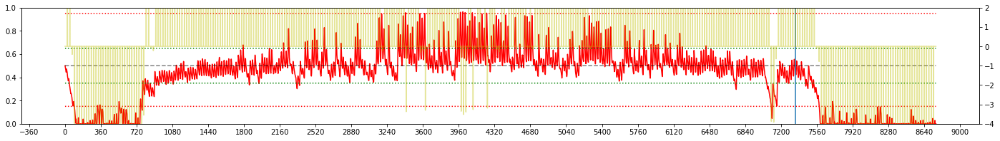


Iteration 26:  WAKKANAI, 2005 
EPSILON = 5.041e-01
LR = 9.997e-05
Average Terminal Reward  = -0.218
Day Violations           =    102
Battery Limit Violations =   1504
Action MEAN              =  3.896
Action STD DEV           =  2.864


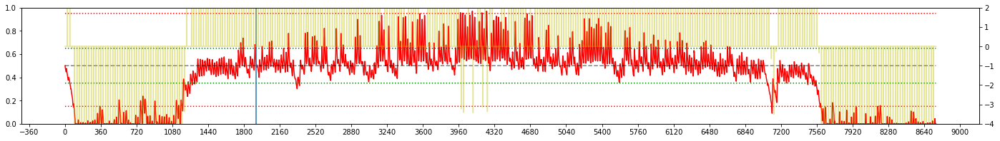


Iteration 27:  WAKKANAI, 2008 
EPSILON = 5.050e-01
LR = 9.998e-05
Average Terminal Reward  =  0.051
Day Violations           =     95
Battery Limit Violations =   1301
Action MEAN              =  3.648
Action STD DEV           =  2.747


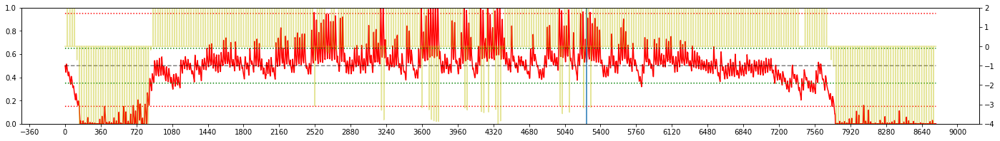


Iteration 28:  WAKKANAI, 2009 
EPSILON = 5.061e-01
LR = 9.998e-05
Average Terminal Reward  = -0.285
Day Violations           =    107
Battery Limit Violations =   1512
Action MEAN              =  3.633
Action STD DEV           =  2.638


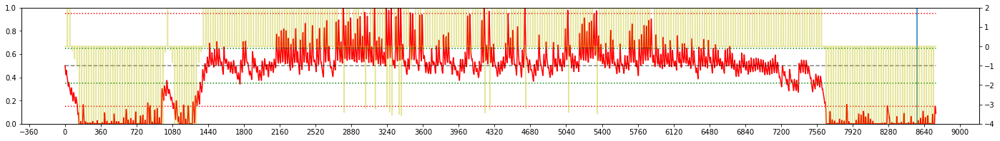


Iteration 29:  WAKKANAI, 2003 
EPSILON = 5.074e-01
LR = 9.999e-05
Average Terminal Reward  =  0.163
Day Violations           =     86
Battery Limit Violations =   1180
Action MEAN              =  3.697
Action STD DEV           =  2.787


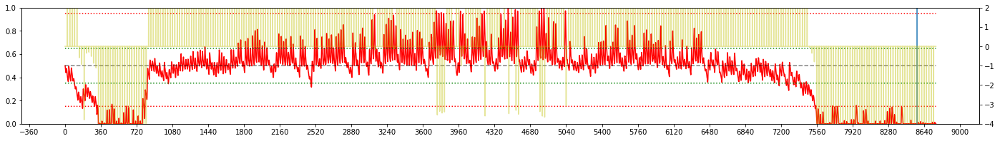


Iteration 30:  WAKKANAI, 2009 
EPSILON = 5.090e-01
LR = 9.999e-05
Average Terminal Reward  =  0.085
Day Violations           =     88
Battery Limit Violations =   1236
Action MEAN              =  3.485
Action STD DEV           =  2.701


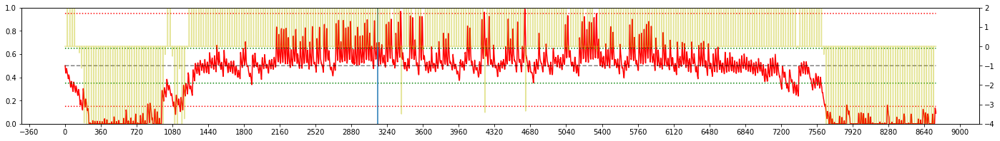


Iteration 31:  WAKKANAI, 2005 
EPSILON = 5.109e-01
LR = 9.999e-05
Average Terminal Reward  = -0.036
Day Violations           =     96
Battery Limit Violations =   1154
Action MEAN              =  3.681
Action STD DEV           =  2.768


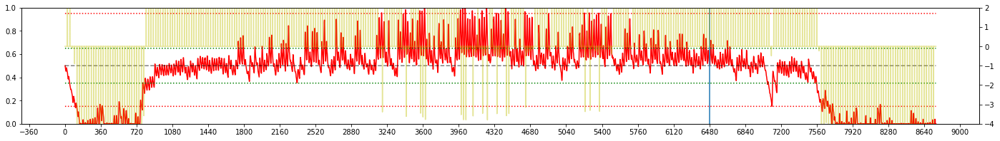


Iteration 32:  WAKKANAI, 2006 
EPSILON = 5.133e-01
LR = 1.000e-04
Average Terminal Reward  =  0.195
Day Violations           =     85
Battery Limit Violations =   1184
Action MEAN              =  3.497
Action STD DEV           =  2.754


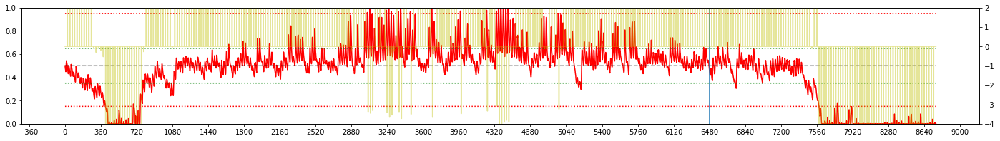


Iteration 33:  WAKKANAI, 2008 
EPSILON = 5.161e-01
LR = 1.000e-04
Average Terminal Reward  =  0.171
Day Violations           =     87
Battery Limit Violations =   1260
Action MEAN              =  3.639
Action STD DEV           =  2.858


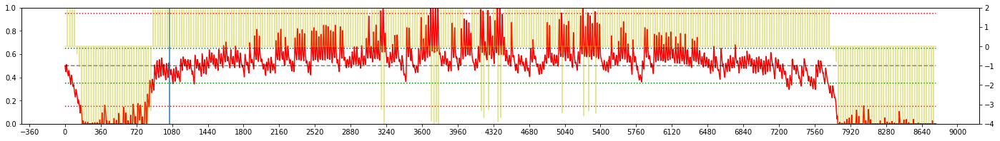


Iteration 34:  WAKKANAI, 2007 
EPSILON = 5.196e-01
LR = 1.000e-04
Average Terminal Reward  =  0.149
Day Violations           =     85
Battery Limit Violations =   1194
Action MEAN              =  3.581
Action STD DEV           =  2.791


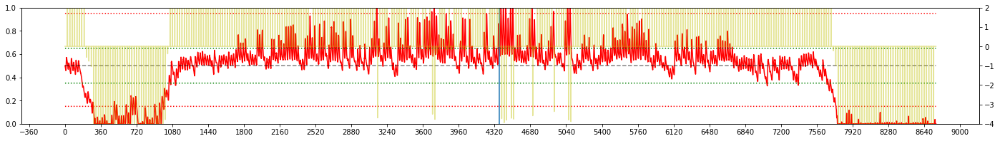


Iteration 35:  WAKKANAI, 2002 
EPSILON = 5.237e-01
LR = 1.000e-04
Average Terminal Reward  =  0.074
Day Violations           =     91
Battery Limit Violations =   1210
Action MEAN              =  3.575
Action STD DEV           =  2.742


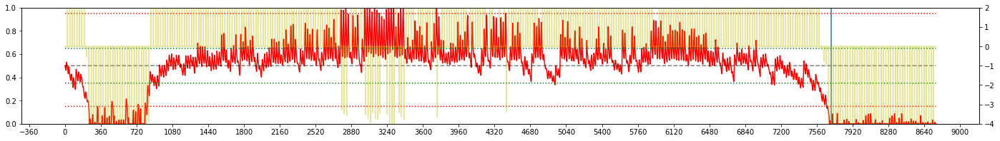


Iteration 36:  WAKKANAI, 2007 
EPSILON = 5.287e-01
LR = 1.000e-04
Average Terminal Reward  =  0.067
Day Violations           =     90
Battery Limit Violations =   1084
Action MEAN              =  3.506
Action STD DEV           =  2.725


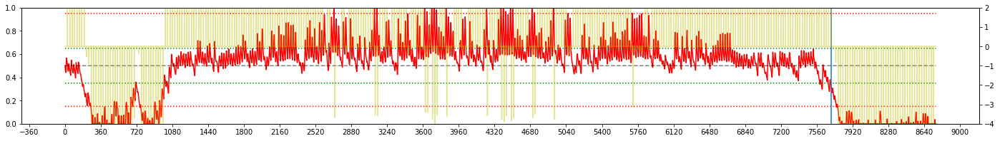


Iteration 37:  WAKKANAI, 2000 
EPSILON = 5.346e-01
LR = 1.000e-04
Average Terminal Reward  =  0.286
Day Violations           =     75
Battery Limit Violations =   1161
Action MEAN              =  3.329
Action STD DEV           =  2.687


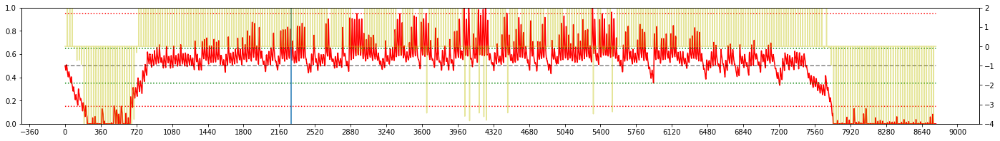


Iteration 38:  WAKKANAI, 2007 
EPSILON = 5.416e-01
LR = 1.000e-04
Average Terminal Reward  =  0.230
Day Violations           =     84
Battery Limit Violations =    979
Action MEAN              =  3.489
Action STD DEV           =  2.905


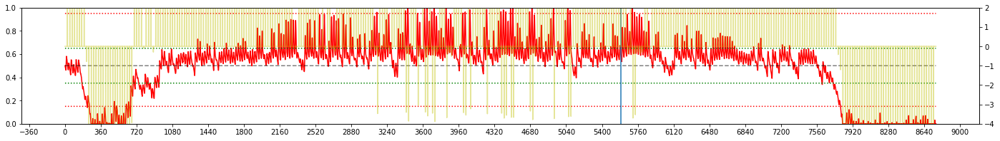


Iteration 39:  WAKKANAI, 2009 
EPSILON = 5.499e-01
LR = 1.000e-04
Average Terminal Reward  = -0.240
Day Violations           =    101
Battery Limit Violations =   1282
Action MEAN              =  3.438
Action STD DEV           =  2.868


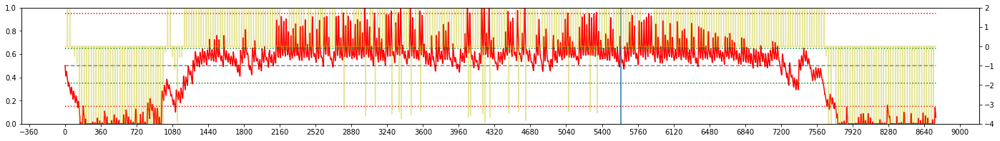


Iteration 40:  WAKKANAI, 2005 
EPSILON = 5.596e-01
LR = 1.000e-04
Average Terminal Reward  = -0.087
Day Violations           =     95
Battery Limit Violations =   1035
Action MEAN              =  3.515
Action STD DEV           =  2.991


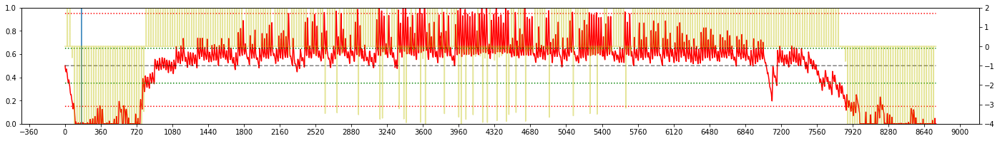


Iteration 41:  WAKKANAI, 2008 
EPSILON = 5.709e-01
LR = 1.000e-04
Average Terminal Reward  = -0.077
Day Violations           =     90
Battery Limit Violations =   1154
Action MEAN              =  3.487
Action STD DEV           =  2.894


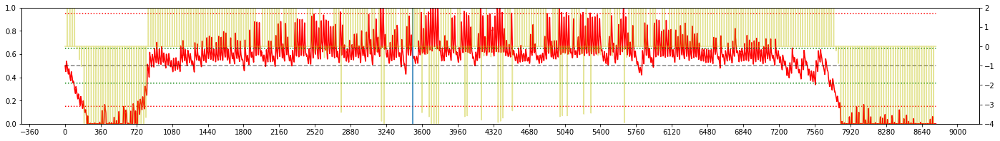


Iteration 42:  WAKKANAI, 2003 
EPSILON = 5.840e-01
LR = 1.000e-04
Average Terminal Reward  = -0.020
Day Violations           =     83
Battery Limit Violations =    983
Action MEAN              =  3.639
Action STD DEV           =  2.989


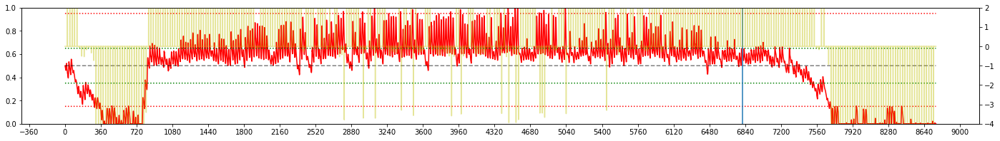


Iteration 43:  WAKKANAI, 2005 
EPSILON = 5.989e-01
LR = 1.000e-04
Average Terminal Reward  =  0.013
Day Violations           =     83
Battery Limit Violations =   1076
Action MEAN              =  3.603
Action STD DEV           =  3.029


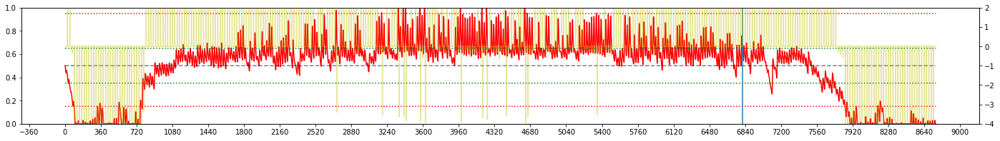


Iteration 44:  WAKKANAI, 2008 
EPSILON = 6.157e-01
LR = 1.000e-04
Average Terminal Reward  = -0.136
Day Violations           =     90
Battery Limit Violations =   1186
Action MEAN              =  3.559
Action STD DEV           =  2.818


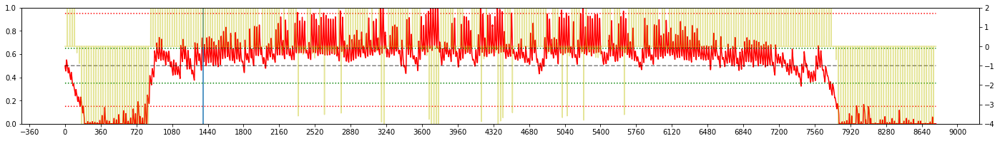


Iteration 45:  WAKKANAI, 2000 
EPSILON = 6.345e-01
LR = 1.000e-04
Average Terminal Reward  =  0.185
Day Violations           =     78
Battery Limit Violations =   1138
Action MEAN              =  3.352
Action STD DEV           =  2.728


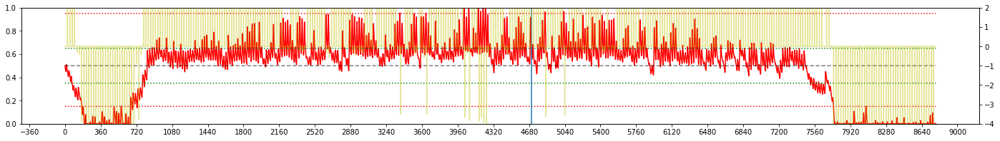


Iteration 46:  WAKKANAI, 2001 
EPSILON = 6.550e-01
LR = 1.000e-04
Average Terminal Reward  = -0.482
Day Violations           =    109
Battery Limit Violations =   1548
Action MEAN              =  3.600
Action STD DEV           =  2.787


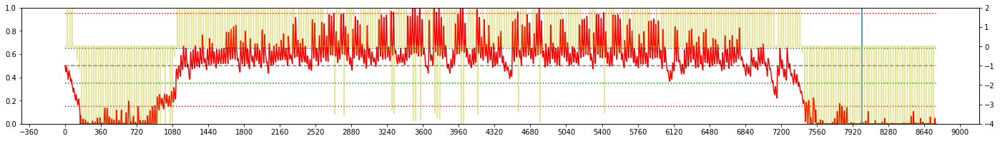


Iteration 47:  WAKKANAI, 2007 
EPSILON = 6.772e-01
LR = 1.000e-04
Average Terminal Reward  =  0.433
Day Violations           =     68
Battery Limit Violations =    770
Action MEAN              =  3.421
Action STD DEV           =  2.717


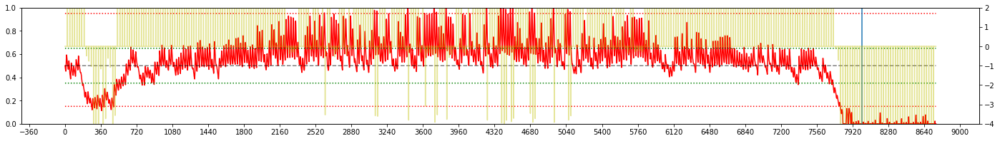


Iteration 48:  WAKKANAI, 2006 
EPSILON = 7.007e-01
LR = 1.000e-04
Average Terminal Reward  =  0.154
Day Violations           =     82
Battery Limit Violations =   1094
Action MEAN              =  3.485
Action STD DEV           =  2.675


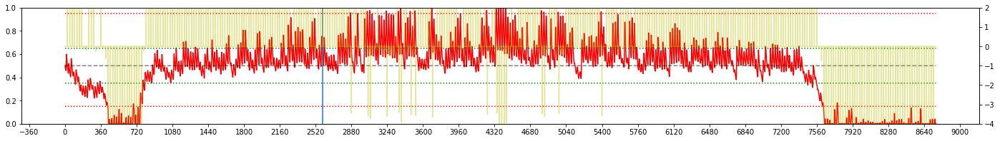


Iteration 49:  WAKKANAI, 2009 
EPSILON = 7.251e-01
LR = 1.000e-04
Average Terminal Reward  =  0.003
Day Violations           =     81
Battery Limit Violations =   1425
Action MEAN              =  3.588
Action STD DEV           =  2.633


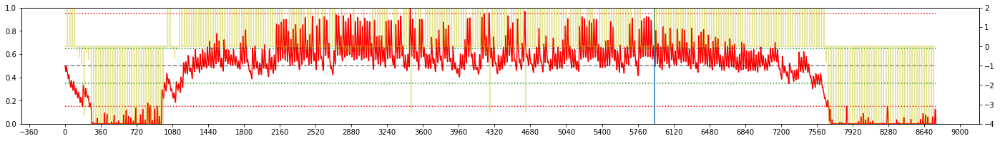


Iteration 50:  WAKKANAI, 2007 
EPSILON = 7.500e-01
LR = 1.000e-04
Average Terminal Reward  =  0.324
Day Violations           =     78
Battery Limit Violations =   1028
Action MEAN              =  3.506
Action STD DEV           =  2.653


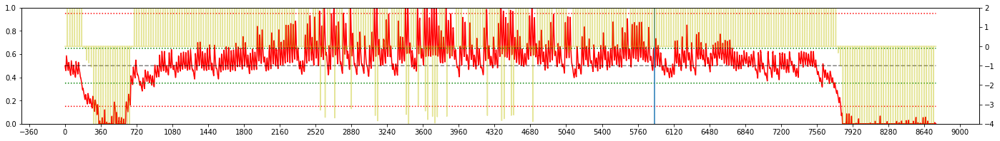


Iteration 51:  WAKKANAI, 2008 
EPSILON = 7.749e-01
LR = 8.750e-05
Average Terminal Reward  =  0.339
Day Violations           =     76
Battery Limit Violations =   1193
Action MEAN              =  3.520
Action STD DEV           =  2.678


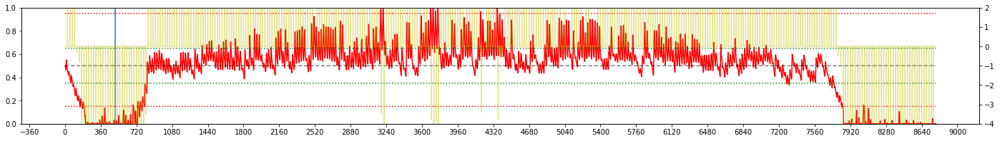


Iteration 52:  WAKKANAI, 2001 
EPSILON = 7.993e-01
LR = 7.681e-05
Average Terminal Reward  =  0.165
Day Violations           =     76
Battery Limit Violations =   1138
Action MEAN              =  3.406
Action STD DEV           =  2.735


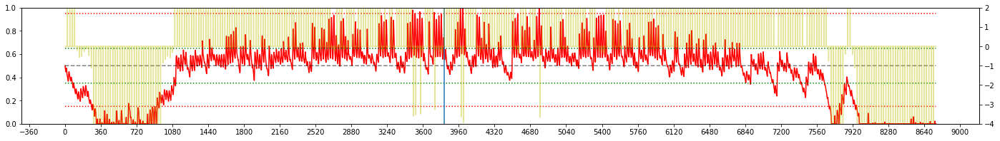


Iteration 53:  WAKKANAI, 2001 
EPSILON = 8.228e-01
LR = 6.767e-05
Average Terminal Reward  =  0.255
Day Violations           =     74
Battery Limit Violations =   1030
Action MEAN              =  3.329
Action STD DEV           =  2.757


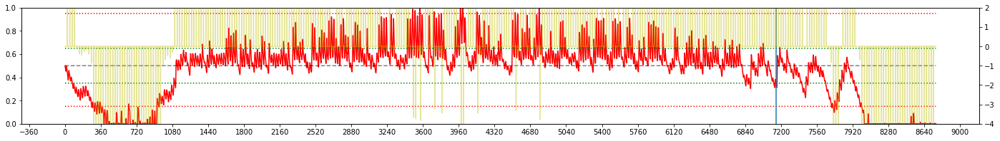


Iteration 54:  WAKKANAI, 2002 
EPSILON = 8.450e-01
LR = 5.986e-05
Average Terminal Reward  =  0.808
Day Violations           =     50
Battery Limit Violations =    853
Action MEAN              =  3.395
Action STD DEV           =  2.845


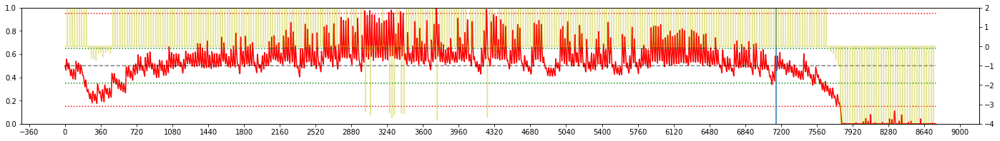


Iteration 55:  WAKKANAI, 2004 
EPSILON = 8.655e-01
LR = 5.318e-05
Average Terminal Reward  =  0.410
Day Violations           =     72
Battery Limit Violations =   1023
Action MEAN              =  3.536
Action STD DEV           =  2.854


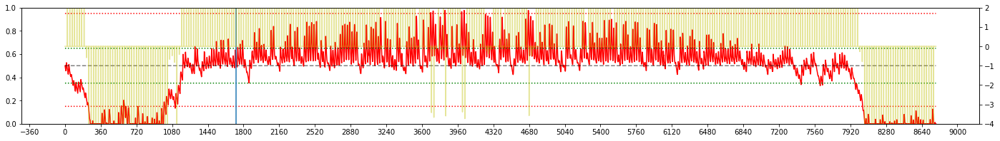


Iteration 56:  WAKKANAI, 2007 
EPSILON = 8.843e-01
LR = 4.747e-05
Average Terminal Reward  =  0.843
Day Violations           =     49
Battery Limit Violations =    809
Action MEAN              =  3.465
Action STD DEV           =  2.884


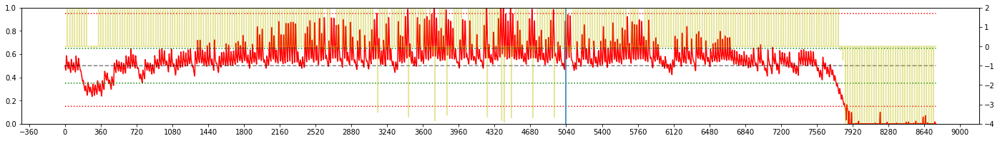


Iteration 57:  WAKKANAI, 2008 
EPSILON = 9.011e-01
LR = 4.259e-05
Average Terminal Reward  =  0.380
Day Violations           =     71
Battery Limit Violations =   1102
Action MEAN              =  3.520
Action STD DEV           =  2.783


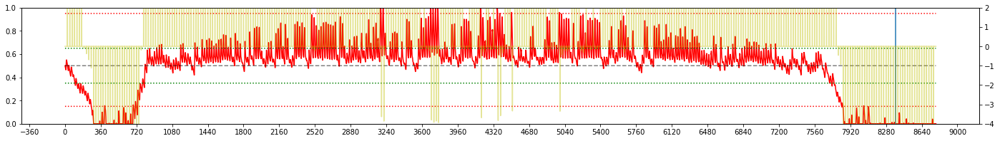


Iteration 58:  WAKKANAI, 2006 
EPSILON = 9.160e-01
LR = 3.841e-05
Average Terminal Reward  =  0.917
Day Violations           =     44
Battery Limit Violations =    635
Action MEAN              =  3.275
Action STD DEV           =  2.861


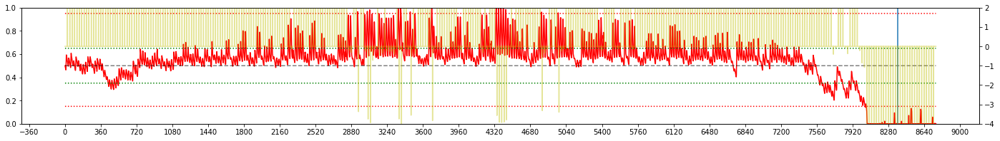


Iteration 59:  WAKKANAI, 2006 
EPSILON = 9.291e-01
LR = 3.484e-05
Average Terminal Reward  =  0.892
Day Violations           =     44
Battery Limit Violations =    584
Action MEAN              =  3.423
Action STD DEV           =  3.136


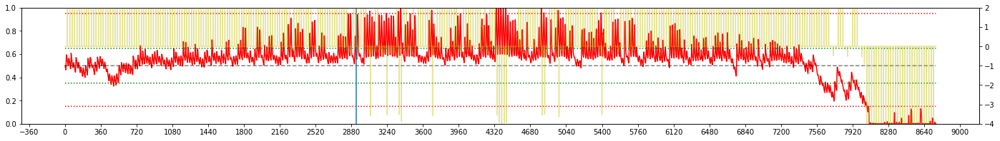


Iteration 60:  WAKKANAI, 2005 
EPSILON = 9.404e-01
LR = 3.179e-05
Average Terminal Reward  =  0.426
Day Violations           =     71
Battery Limit Violations =    691
Action MEAN              =  3.511
Action STD DEV           =  3.197


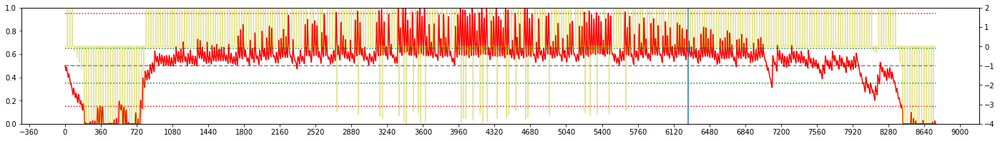


Iteration 61:  WAKKANAI, 2009 
EPSILON = 9.501e-01
LR = 2.918e-05
Average Terminal Reward  = -0.064
Day Violations           =     94
Battery Limit Violations =   1154
Action MEAN              =  3.445
Action STD DEV           =  3.010


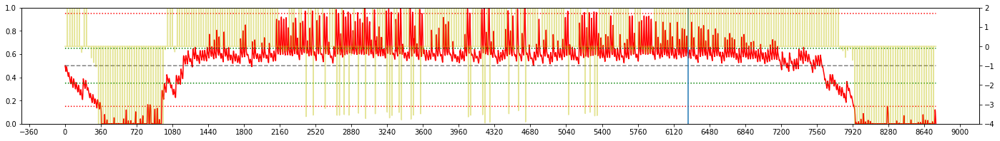


Iteration 62:  WAKKANAI, 2006 
EPSILON = 9.584e-01
LR = 2.695e-05
Average Terminal Reward  =  0.825
Day Violations           =     50
Battery Limit Violations =    611
Action MEAN              =  3.215
Action STD DEV           =  3.017


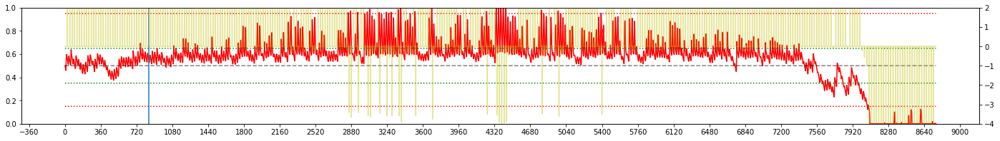


Iteration 63:  WAKKANAI, 2003 
EPSILON = 9.654e-01
LR = 2.504e-05
Average Terminal Reward  =  0.696
Day Violations           =     55
Battery Limit Violations =    513
Action MEAN              =  3.444
Action STD DEV           =  3.217


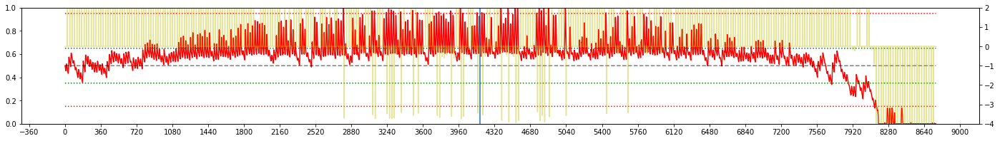


Iteration 64:  WAKKANAI, 2004 
EPSILON = 9.713e-01
LR = 2.341e-05
Average Terminal Reward  =  0.501
Day Violations           =     63
Battery Limit Violations =    806
Action MEAN              =  3.378
Action STD DEV           =  2.997


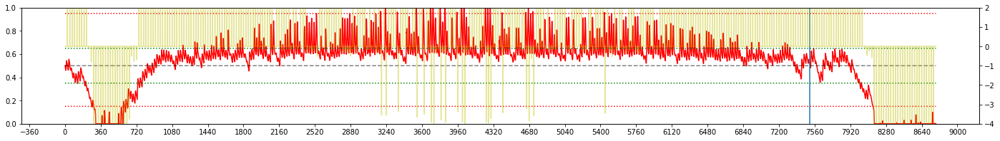


Iteration 65:  WAKKANAI, 2001 
EPSILON = 9.763e-01
LR = 2.202e-05
Average Terminal Reward  =  0.623
Day Violations           =     59
Battery Limit Violations =    637
Action MEAN              =  3.171
Action STD DEV           =  2.816


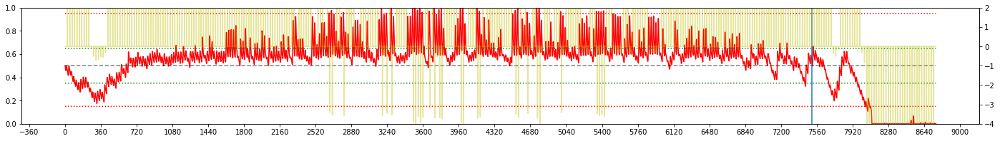


Iteration 66:  WAKKANAI, 2000 
EPSILON = 9.804e-01
LR = 2.082e-05
Average Terminal Reward  =  0.415
Day Violations           =     65
Battery Limit Violations =    934
Action MEAN              =  3.231
Action STD DEV           =  2.715


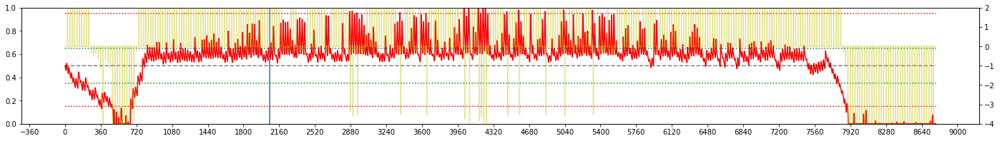


Iteration 67:  WAKKANAI, 2003 
EPSILON = 9.839e-01
LR = 1.980e-05
Average Terminal Reward  =  0.785
Day Violations           =     52
Battery Limit Violations =    528
Action MEAN              =  3.462
Action STD DEV           =  2.933


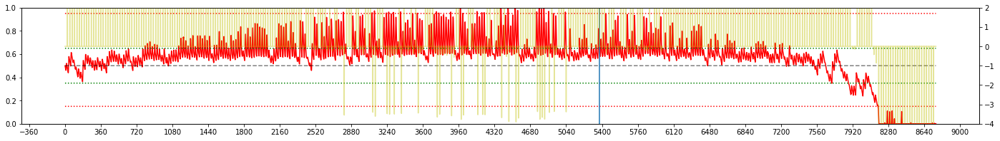


Iteration 68:  WAKKANAI, 2003 
EPSILON = 9.867e-01
LR = 1.893e-05
Average Terminal Reward  =  0.847
Day Violations           =     42
Battery Limit Violations =    519
Action MEAN              =  3.414
Action STD DEV           =  3.076


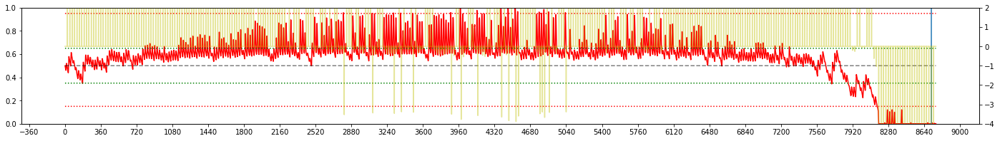


Iteration 69:  WAKKANAI, 2000 
EPSILON = 9.891e-01
LR = 1.819e-05
Average Terminal Reward  =  0.466
Day Violations           =     62
Battery Limit Violations =    903
Action MEAN              =  3.239
Action STD DEV           =  2.949


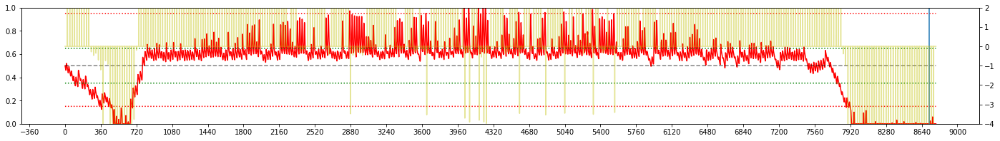


Iteration 70:  WAKKANAI, 2009 
EPSILON = 9.910e-01
LR = 1.755e-05
Average Terminal Reward  =  0.304
Day Violations           =     67
Battery Limit Violations =   1050
Action MEAN              =  3.401
Action STD DEV           =  2.934


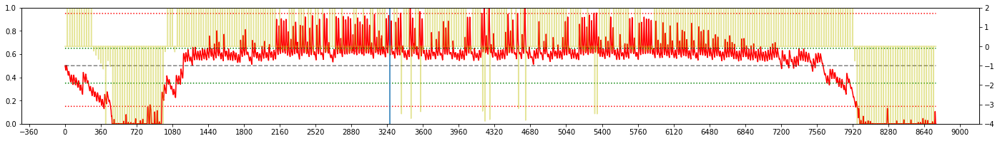


Iteration 71:  WAKKANAI, 2007 
EPSILON = 9.926e-01
LR = 1.701e-05
Average Terminal Reward  =  0.848
Day Violations           =     44
Battery Limit Violations =    634
Action MEAN              =  3.322
Action STD DEV           =  3.041


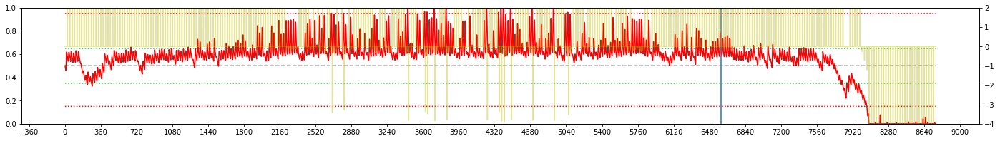


Iteration 72:  WAKKANAI, 2004 
EPSILON = 9.939e-01
LR = 1.654e-05
Average Terminal Reward  =  0.555
Day Violations           =     60
Battery Limit Violations =    797
Action MEAN              =  3.345
Action STD DEV           =  2.858


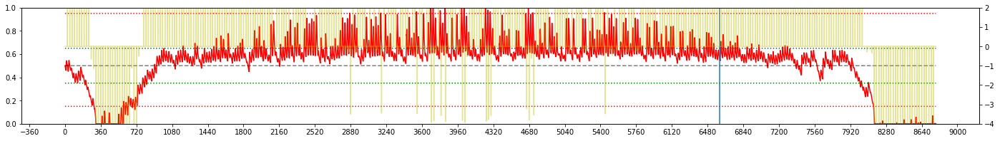


Iteration 73:  WAKKANAI, 2003 
EPSILON = 9.950e-01
LR = 1.614e-05
Average Terminal Reward  =  0.983
Day Violations           =     32
Battery Limit Violations =    513
Action MEAN              =  3.412
Action STD DEV           =  2.999


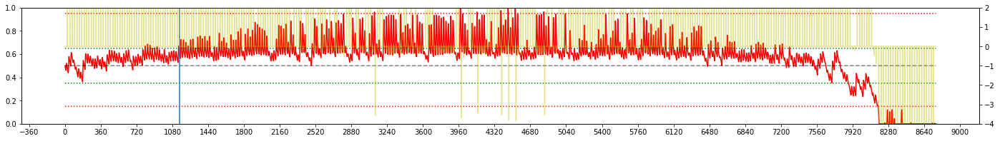


Iteration 74:  WAKKANAI, 2005 
EPSILON = 9.959e-01
LR = 1.580e-05
Average Terminal Reward  =  0.573
Day Violations           =     54
Battery Limit Violations =    677
Action MEAN              =  3.366
Action STD DEV           =  3.027


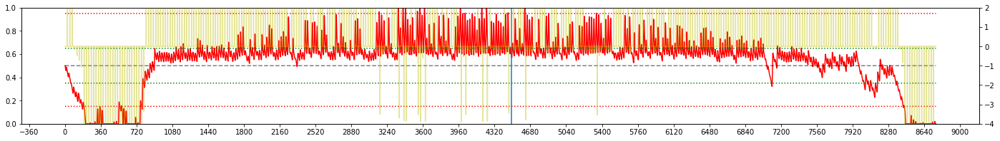


Iteration 75:  WAKKANAI, 2000 
EPSILON = 9.967e-01
LR = 1.551e-05
Average Terminal Reward  =  0.734
Day Violations           =     46
Battery Limit Violations =    756
Action MEAN              =  3.163
Action STD DEV           =  2.835


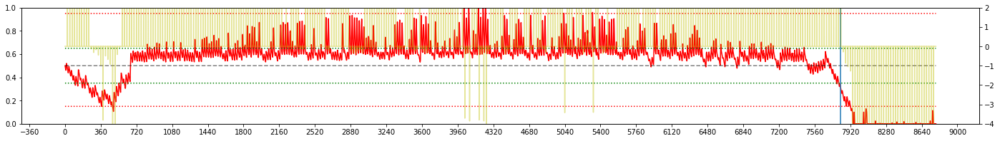


Iteration 76:  WAKKANAI, 2006 
EPSILON = 9.973e-01
LR = 1.526e-05
Average Terminal Reward  =  1.027
Day Violations           =     34
Battery Limit Violations =    568
Action MEAN              =  3.191
Action STD DEV           =  2.865


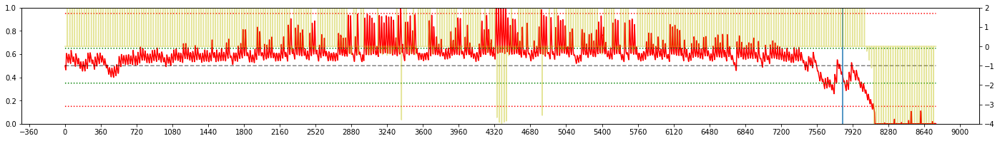


Iteration 77:  WAKKANAI, 2001 
EPSILON = 9.978e-01
LR = 1.505e-05
Average Terminal Reward  =  0.855
Day Violations           =     39
Battery Limit Violations =    614
Action MEAN              =  3.171
Action STD DEV           =  2.891


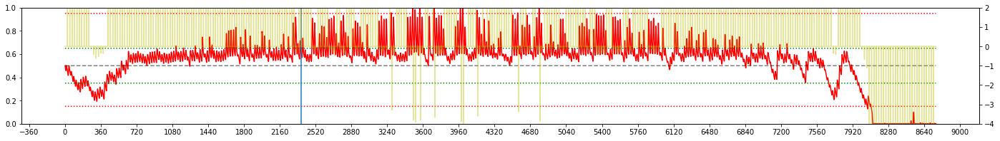


Iteration 78:  WAKKANAI, 2007 
EPSILON = 9.982e-01
LR = 1.487e-05
Average Terminal Reward  =  0.877
Day Violations           =     41
Battery Limit Violations =    620
Action MEAN              =  3.317
Action STD DEV           =  2.988


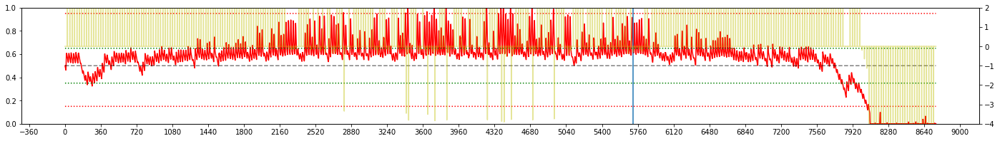


Iteration 79:  WAKKANAI, 2004 
EPSILON = 9.985e-01
LR = 1.471e-05
Average Terminal Reward  =  0.627
Day Violations           =     54
Battery Limit Violations =    774
Action MEAN              =  3.335
Action STD DEV           =  3.019


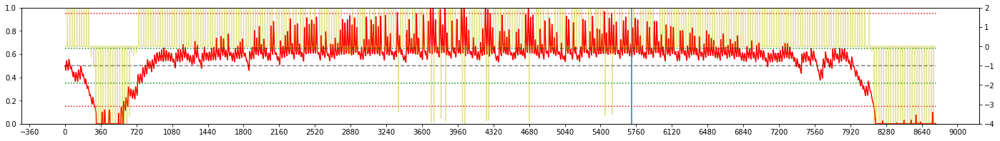


Iteration 80:  WAKKANAI, 2005 
EPSILON = 9.988e-01
LR = 1.458e-05
Average Terminal Reward  =  0.668
Day Violations           =     49
Battery Limit Violations =    629
Action MEAN              =  3.349
Action STD DEV           =  3.113


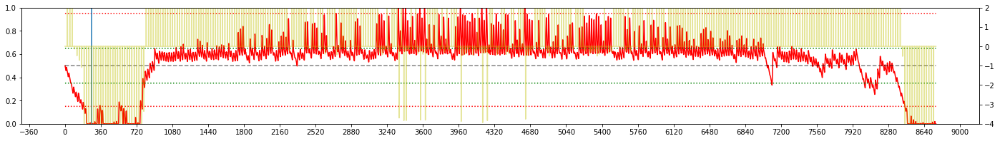


Iteration 81:  WAKKANAI, 2005 
EPSILON = 9.990e-01
LR = 1.446e-05
Average Terminal Reward  =  0.621
Day Violations           =     53
Battery Limit Violations =    665
Action MEAN              =  3.363
Action STD DEV           =  3.144


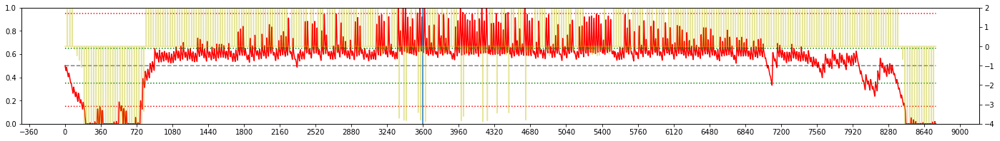


Iteration 82:  WAKKANAI, 2001 
EPSILON = 9.992e-01
LR = 1.437e-05
Average Terminal Reward  =  0.811
Day Violations           =     42
Battery Limit Violations =    628
Action MEAN              =  3.174
Action STD DEV           =  3.116


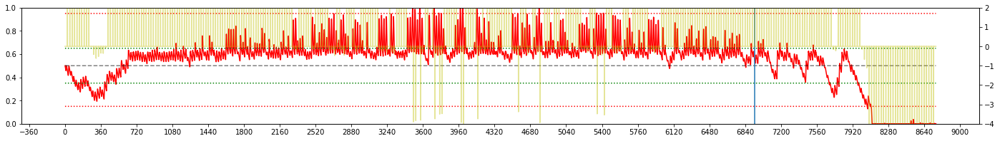


Iteration 83:  WAKKANAI, 2006 
EPSILON = 9.993e-01
LR = 1.428e-05
Average Terminal Reward  =  0.968
Day Violations           =     38
Battery Limit Violations =    576
Action MEAN              =  3.188
Action STD DEV           =  3.076


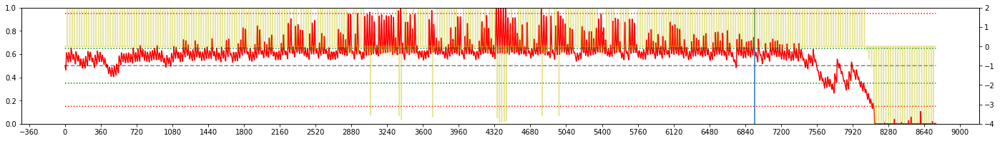


Iteration 84:  WAKKANAI, 2009 
EPSILON = 9.994e-01
LR = 1.421e-05
Average Terminal Reward  =  0.433
Day Violations           =     53
Battery Limit Violations =    878
Action MEAN              =  3.279
Action STD DEV           =  3.043


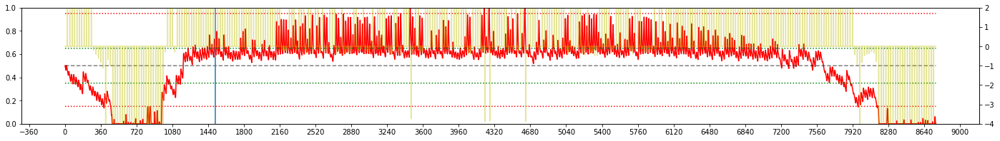


Iteration 85:  WAKKANAI, 2003 
EPSILON = 9.995e-01
LR = 1.415e-05
Average Terminal Reward  =  0.905
Day Violations           =     36
Battery Limit Violations =    508
Action MEAN              =  3.409
Action STD DEV           =  3.206


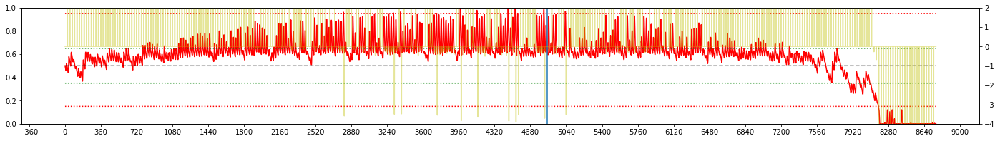


Iteration 86:  WAKKANAI, 2003 
EPSILON = 9.996e-01
LR = 1.410e-05
Average Terminal Reward  =  0.912
Day Violations           =     36
Battery Limit Violations =    509
Action MEAN              =  3.411
Action STD DEV           =  3.205


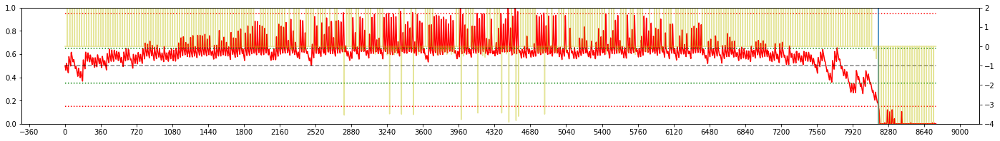


Iteration 87:  WAKKANAI, 2000 
EPSILON = 9.997e-01
LR = 1.406e-05
Average Terminal Reward  =  0.668
Day Violations           =     50
Battery Limit Violations =    770
Action MEAN              =  3.166
Action STD DEV           =  2.964


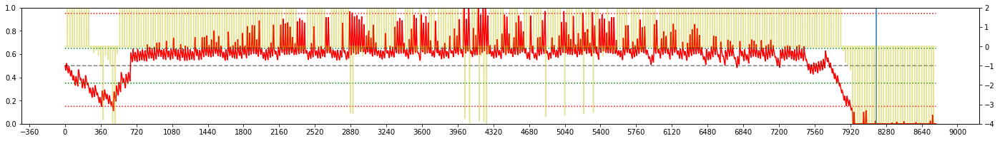


Iteration 88:  WAKKANAI, 2005 
EPSILON = 9.997e-01
LR = 1.402e-05
Average Terminal Reward  =  0.425
Day Violations           =     64
Battery Limit Violations =    684
Action MEAN              =  3.366
Action STD DEV           =  3.115


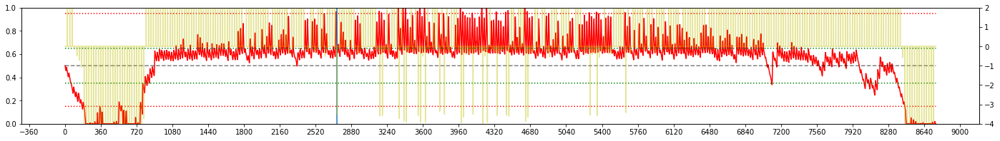


Iteration 89:  WAKKANAI, 2009 
EPSILON = 9.998e-01
LR = 1.398e-05
Average Terminal Reward  =  0.312
Day Violations           =     62
Battery Limit Violations =    832
Action MEAN              =  3.256
Action STD DEV           =  3.021


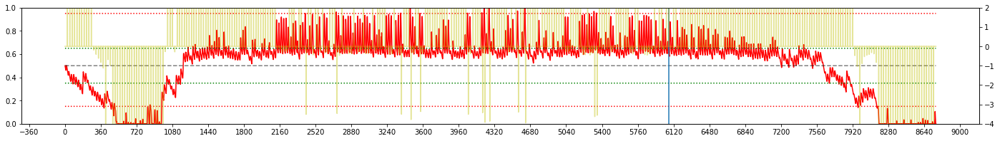


Iteration 90:  WAKKANAI, 2007 
EPSILON = 9.998e-01
LR = 1.396e-05
Average Terminal Reward  =  0.688
Day Violations           =     56
Battery Limit Violations =    621
Action MEAN              =  3.310
Action STD DEV           =  3.083


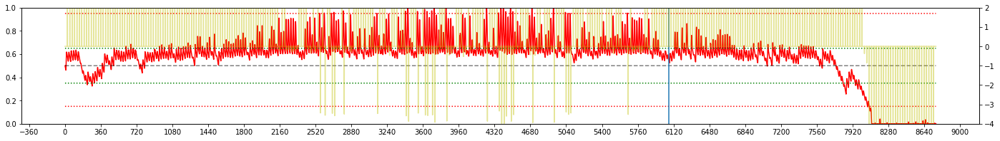


Iteration 91:  WAKKANAI, 2005 
EPSILON = 9.999e-01
LR = 1.393e-05
Average Terminal Reward  =  0.530
Day Violations           =     56
Battery Limit Violations =    690
Action MEAN              =  3.373
Action STD DEV           =  3.112


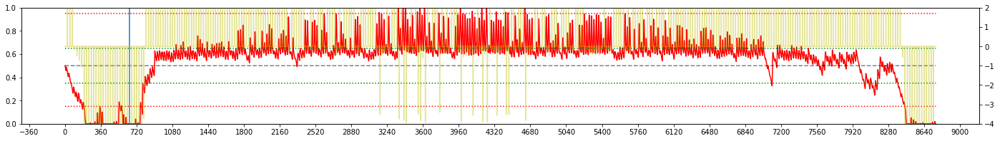


Iteration 92:  WAKKANAI, 2004 
EPSILON = 9.999e-01
LR = 1.391e-05
Average Terminal Reward  =  0.056
Day Violations           =     82
Battery Limit Violations =   1159
Action MEAN              =  3.486
Action STD DEV           =  3.005


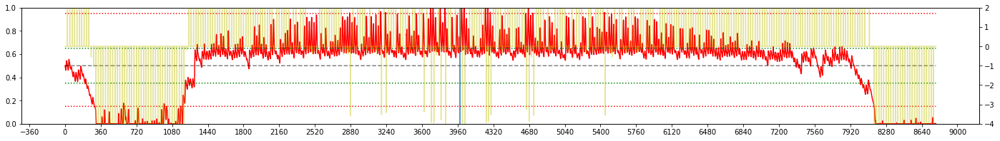


Iteration 93:  WAKKANAI, 2001 
EPSILON = 9.999e-01
LR = 1.390e-05
Average Terminal Reward  =  0.749
Day Violations           =     48
Battery Limit Violations =    626
Action MEAN              =  3.173
Action STD DEV           =  3.058


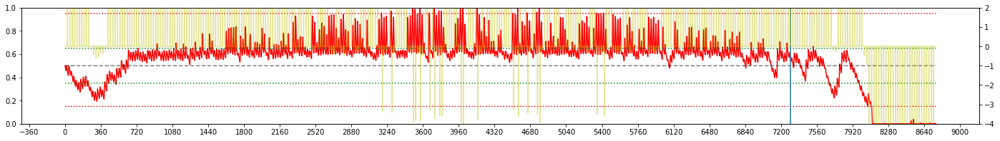


Iteration 94:  WAKKANAI, 2000 
EPSILON = 9.999e-01
LR = 1.388e-05
Average Terminal Reward  =  0.493
Day Violations           =     59
Battery Limit Violations =    891
Action MEAN              =  3.218
Action STD DEV           =  2.897


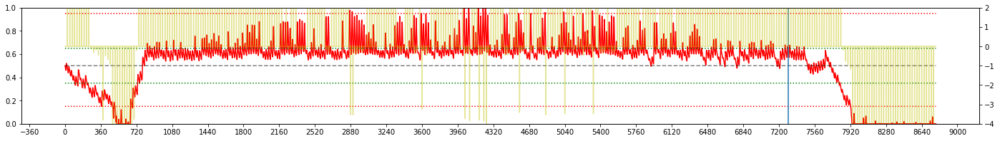


Iteration 95:  WAKKANAI, 2008 
EPSILON = 9.999e-01
LR = 1.387e-05
Average Terminal Reward  =  0.459
Day Violations           =     57
Battery Limit Violations =    848
Action MEAN              =  3.364
Action STD DEV           =  3.005


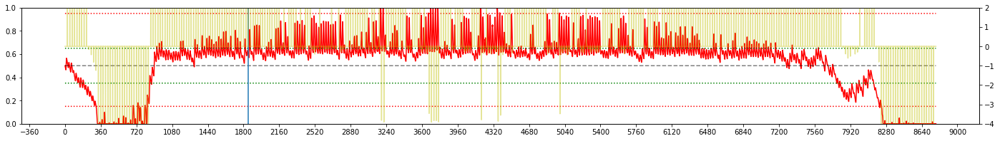


Iteration 96:  WAKKANAI, 2005 
EPSILON = 9.999e-01
LR = 1.386e-05
Average Terminal Reward  =  0.562
Day Violations           =     55
Battery Limit Violations =    728
Action MEAN              =  3.389
Action STD DEV           =  3.108


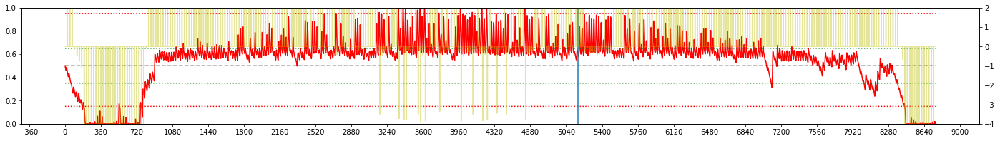


Iteration 97:  WAKKANAI, 2006 
EPSILON = 1.000e+00
LR = 1.385e-05
Average Terminal Reward  =  1.032
Day Violations           =     36
Battery Limit Violations =    579
Action MEAN              =  3.189
Action STD DEV           =  3.045


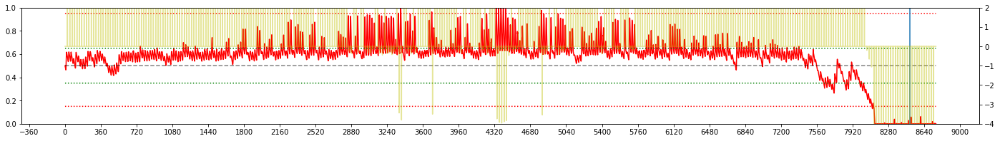


Iteration 98:  WAKKANAI, 2002 
EPSILON = 1.000e+00
LR = 1.384e-05
Average Terminal Reward  =  0.706
Day Violations           =     55
Battery Limit Violations =    805
Action MEAN              =  3.358
Action STD DEV           =  3.069


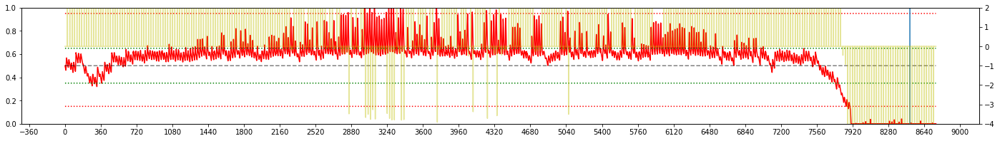


Iteration 99:  WAKKANAI, 2000 
EPSILON = 1.000e+00
LR = 1.383e-05
Average Terminal Reward  =  0.755
Day Violations           =     48
Battery Limit Violations =    761
Action MEAN              =  3.166
Action STD DEV           =  2.945


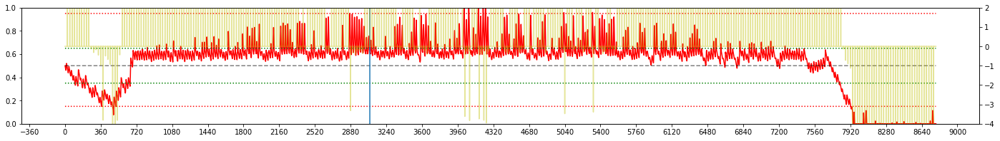

In [17]:
#TRAIN 
dqn = DQN()
# for recording weights
oldfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
old2fc1 = oldfc1

# oldfc2 = dqn.eval_net.fc2.weight.data.cpu().numpy().flatten()
# old2fc2 = oldfc2

# oldfc3 = dqn.eval_net.fc3.weight.data.cpu().numpy().flatten()
# old2fc3 = oldfc3

oldout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
old2out = oldout
########################################

change_hr = 0 #when dqn target_net is updated by eval_net
avg_reward_rec = [] #record the yearly average rewards over the entire duration of training
batt_violation_rec = []
day_violation_rec = []

print('Device: ', dqn.device)
#TRAINING STARTS
tic = datetime.now()

e_rec = []
lr_rec = []
for iteration in range(NO_OF_ITERATIONS):
    # EPSILON SCHEDULING
    e_slope = 5
    e_start = 0.5
    e_inflection_point = 50
    EPSILON = e_start + (1-e_start)/(1 + np.exp(-(iteration-e_inflection_point)/e_slope))

    # LR SCEHDULING
    lr_slope = 3
    lr_start = 0
    lr_inflection_point = 2
    if iteration <=50:
        lrate =  (lr_start + (1-lr_start)/(1 + np.exp(-(iteration-lr_inflection_point)/lr_slope)))*1e-4
    else:
        lrate = 0.95*(lrate-lrate*0.1)+0.2*1e-5
    dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate)
#     dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate, weight_decay=WT_DECAY))
    lr_rec= np.append(lr_rec,lrate)

    LOCATION    = 'wakkanai'#random.choice(['tokyo','wakkanai','minamidaito'])
    YEAR        = random.choice(np.arange(2000,2010))
    
    capm        = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
    capm.eno    = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
    capm.HMAX   = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object


    s, r, day_end, year_end = capm.reset()
    yr_record      = np.empty(4)
    transition_rec = np.zeros((capm.eno.TIME_STEPS, N_STATES * 2 + 2)) #record all the transition in one day

    while True:
        a = dqn.choose_action(stdize(s))
        yr_record = np.vstack((yr_record, [s[0],s[2],r, a]))

        # take action
        s_, r, day_end, year_end = capm.step(a)
        
        temp_transitions                = np.hstack((stdize(s), [a, r], stdize(s_)))
        transition_rec[capm.eno.hr-1,:] = temp_transitions

        if (day_end):
            transition_rec[:,5]  = r #broadcast reward to all states
            decay_factor         = [i for i in (LAMBDA**n for n in reversed(range(0, capm.eno.TIME_STEPS)))]
            transition_rec[:,5]  = transition_rec[:,5] * decay_factor #decay reward proportionately
            dqn.store_day_transition(transition_rec)

        if dqn.memory_counter > MEMORY_CAPACITY:
            dqn.learn()

        if dqn.nettoggle:
            change_hr = capm.eno.day*24+capm.eno.hr #to mark when the DQN is updated.
            dqn.nettoggle = not dqn.nettoggle

        if (year_end):
            break

        # transition to new state
        s = s_

    yr_record = np.delete(yr_record, 0, 0)     #remove the first row which is garbage
    hourly_yr_reward_rec = yr_record[:,2]      #extract reward information from the record array
    yr_reward_rec = hourly_yr_reward_rec[::24] #only consider terminal rewards

    print('\nIteration {}:  {}, {} '.format(iteration, LOCATION.upper(), YEAR))
    print('EPSILON = {:6.3e}'.format(EPSILON))
    for param_group in dqn.optimizer.param_groups:
        print('LR = {:6.3e}'.format(param_group['lr']))
    print("Average Terminal Reward  = {:6.3f}".format(np.mean(yr_reward_rec)))
    print("Day Violations           = {:6d}".format(capm.violation_counter))
    print("Battery Limit Violations = {:6d}".format(capm.batt_violations))
    print("Action MEAN              = {:6.3f}".format(np.mean(yr_record[:,-1] + 1)))
    print("Action STD DEV           = {:6.3f}".format(np.std(yr_record[:,-1] + 1)))
   
    # Log the average reward in avg_reward_rec to plot later in the learning curve graph figure
    avg_reward_rec      = np.append(avg_reward_rec, np.mean(yr_reward_rec))
    day_violation_rec   = np.append(day_violation_rec, capm.violation_counter)
    batt_violation_rec  = np.append(batt_violation_rec, capm.batt_violations)

###########################################################################################
###########################################################################################
#   PLOT battery levels, hourly rewards and the weights
    
    #PLOT BATTERY AND REWARD
    fig = plt.figure(figsize=(24,3))
    TIME_STEPS = capm.eno.TIME_STEPS
    NO_OF_DAYS = capm.eno.NO_OF_DAYS
    DAY_SPACING = 15
    TICK_SPACING = TIME_STEPS*DAY_SPACING
    
    #plot battery
    ax = fig.add_subplot(111)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS),  yr_record[:,0],'r')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BOPT/capm.BMAX, 'k--', alpha=0.5)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
    ax.set_ylim([0,1])
    ax.axvline(x=change_hr)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(TICK_SPACING))

    #plot hourly reward
    ax0 = ax.twinx()
    ax0.plot(hourly_yr_reward_rec, color='y',alpha=0.4)
    ax0.set_ylim(-4,2)
    
    plt.show()
# # #################################################################
#     # PLOT WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
#     ax1.bar(xaxis, old2fc1, color='b', alpha = 0.3)
#     ax1.bar(xaxis, oldfc1,  color='b', alpha = 0.5)
#     ax1.bar(xaxis, newfc1,  color='b', alpha = 1.0)
#     ax1.set_title("FC1")
# #     ax1.set_ylim([-4,4])
#     ax1.set_ylabel("Weight Value")

#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
#     axO.bar(xaxis, old2out, color='g', alpha = 0.3)
#     axO.bar(xaxis, oldout,  color='g', alpha = 0.5)
#     axO.bar(xaxis, newout,  color='g', alpha = 1.0)
#     axO.set_title("FC OUT")
# #     axO.set_ylim([-4,4])
#     axO.set_ylabel("Weight Value")

#     fig.tight_layout()
#     plt.show()
# # #################################################################

#     # PLOT HISTOGRAM OF WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
# #     ax1.hist(old2fc1, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.1 )
# #     ax1.hist(oldfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.3 )
#     ax1.hist(newfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.6 )
#     ax1.set_title("FC1")
#     ax1.set_xlabel("Weight Value")


#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
# #     axO.hist(old2out, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.1)
# #     axO.hist(oldout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.3)
#     axO.hist(newout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.6)
#     axO.set_title("FC OUT")
#     axO.set_xlabel("Weight Value")


#     fig.tight_layout()
#     plt.show()
# # #################################################################    
    
#     old2fc1 = oldfc1
#     oldfc1 = newfc1
    
#     old2out = oldout
#     oldout = newout

    # End of training

In [18]:
print('Train time: {}\n'.format(datetime.now() - tic))
torch.save(dqn.eval_net.state_dict(), './models/'+ 'demo_' + MODELNAME)

Train time: 0:30:18.839614



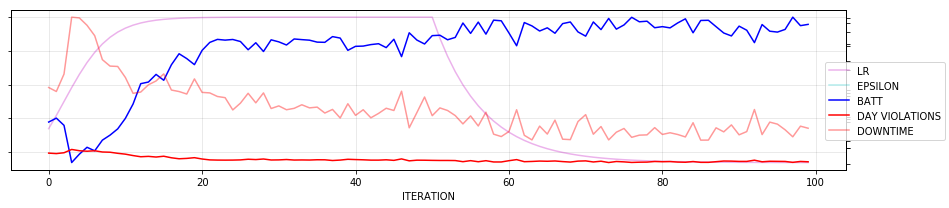

In [19]:
###########################################################################################
###########################################################################################

#PLOT LR AND EPSILON SCHEDULING
fig = plt.figure(figsize=(12,3))
ax = fig.add_subplot(111)
# ax.set_title("LR and EPSILON SCHEDULING V3")
ax.set_xlabel("ITERATION")
# ax.set_ylabel("LR",      color = 'm')
ax.plot(lr_rec,          color = 'm', alpha = 0.3,label="LR")
# ax.tick_params(axis='y', color = 'm')
# ax.ticklabel_format(style='sci', axis='y', scilimits=(-6,-7))
# ax.minorticks_on()

# ax.set_axisbelow(True)
ax.yaxis.set_ticklabels([])

ax.grid(b=True, which='minor', linestyle=':',  color='k', alpha = 0.1)
ax.grid(b=True, which='major', linestyle='-',  color='k', alpha = 0.1)

ax_ = ax.twinx()
# ax_.set_ylabel("EPSILON", color = 'c')
# ax_.tick_params(axis='y', color = 'c')
# ax_.set_axisbelow(True)
# ax_.minorticks_on()
ax_.plot(e_rec,           color = 'c', alpha = 0.3, label="EPSILON")
ax_.yaxis.set_ticklabels([])

# Plot the average reward log
ax1 = ax.twinx()
# ax1.set_ylabel("Terminal Reward", color = 'b')
# ax1.set_ylim([-10,2]);
ax1.plot(avg_reward_rec,'b',label="BATT")
# ax1.tick_params(axis='y', colors='b')
ax1.yaxis.set_ticklabels([])

# Plot the violation record log
ax2 = ax.twinx()
# ax2.set_ylabel("Violations",color = 'r')
ax2.plot(day_violation_rec,'r', label="DAY VIOLATIONS")
ax2.plot(batt_violation_rec,'r',alpha=0.4, label="DOWNTIME")
for xpt in np.argwhere(batt_violation_rec<1):
    ax2.axvline(x=xpt,color='g',linewidth='0.5')
# ax2.set_ylim([0,50]);
# ax2.tick_params(axis='y', colors='r')
ax2.yaxis.set_ticklabels([])

fig.legend(bbox_to_anchor=(1.1, 0.7))


fig.tight_layout()

###########################################################################################
###########################################################################################

In [20]:
# print("ITERATION #0 :  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[0],e_rec[0]))
# print("ITERATION #10:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[10],e_rec[10]))
# print("ITERATION #20:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[20],e_rec[20]))
# print("ITERATION #50:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[50],e_rec[50]))
# print("ITERATION #80:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[80],e_rec[80]))
# print("ITERATION #99:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[99],e_rec[99]))

In [21]:
S_FILENAME = './models/'+ 'demo_'+ MODELNAME
# S_FILENAME = './models/'+ MODELNAME
print("Loading MODEL from FILE: ", S_FILENAME)
dqn = DQN()
dqn.eval_net.load_state_dict(torch.load(S_FILENAME))
dqn.eval_net.eval()
print("DEVICE: ", dqn.device)

Loading MODEL from FILE:  ./models/demo_B1_1_wakkanai_314.pt
DEVICE:  cpu


***MEASURING PERFORMANCE OF THE MODEL***


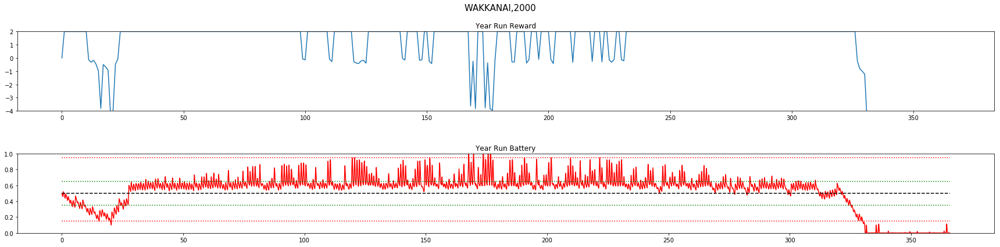

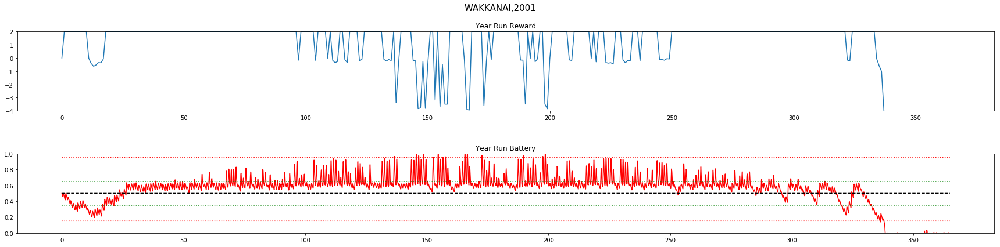

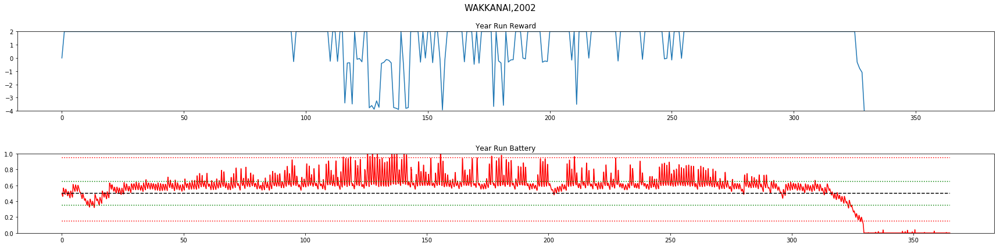

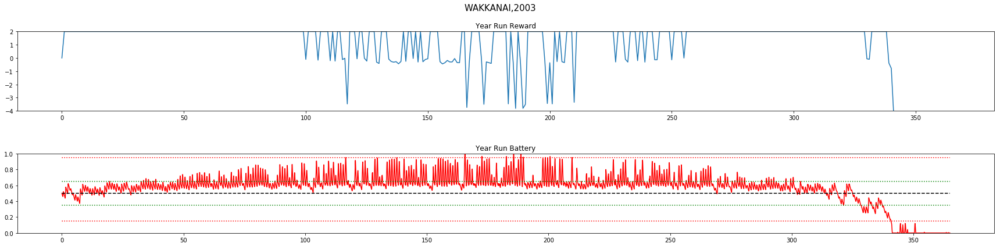

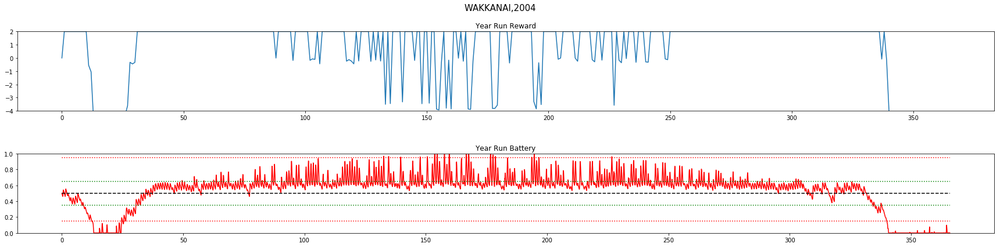

...

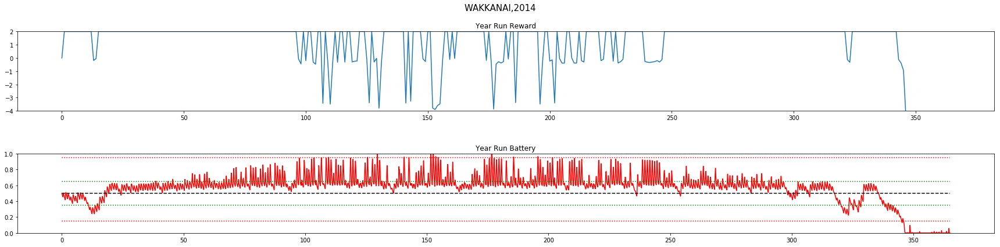

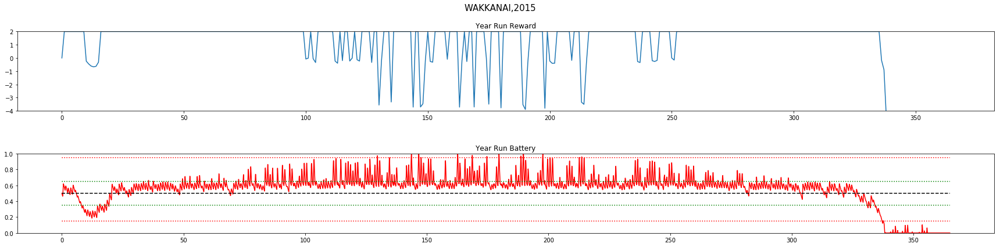

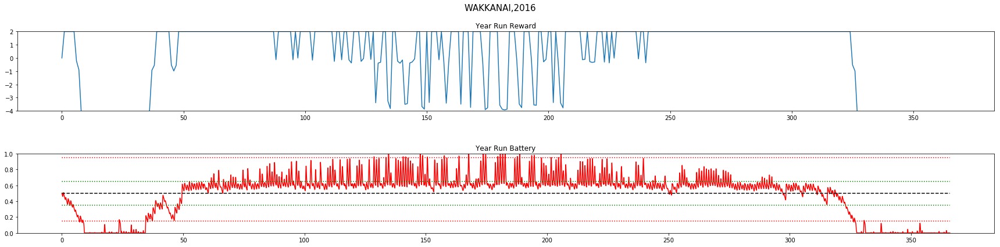

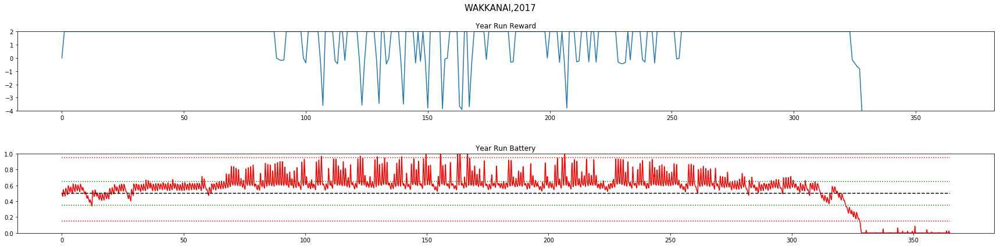

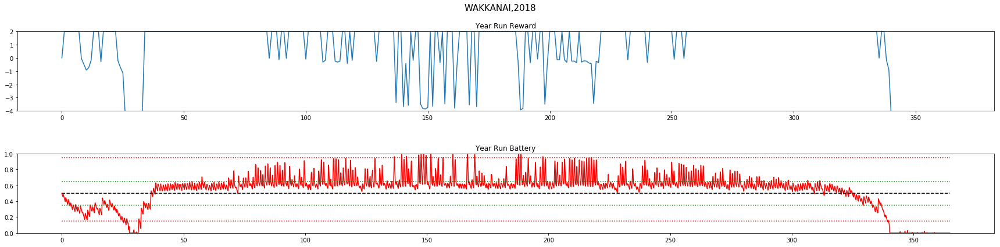



WAKKANAI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 0.8		44	 760
2001	 0.81		43	 622
2002	 0.7		53	 802
2003	 0.97		35	 507
2004	 0.58		60	 782
2005	 0.6		55	 674
2006	 1.02		38	 570
2007	 0.84		46	 627
2008	 0.56		55	 773
2009	 0.46		56	 818
2010	 1.06		35	 476
2011	 0.69		55	 859
2012	 0.8		44	 779
2013	 0.37		67	 874
2014	 1.0		34	 399
2015	 0.94		42	 561
2016	 -0.12		93	 1296
2017	 0.75		48	 808
2018	 0.73		50	 648

TOTAL Day Violations:   953.0
TOTAL Batt Violations:  13635.0
************************************


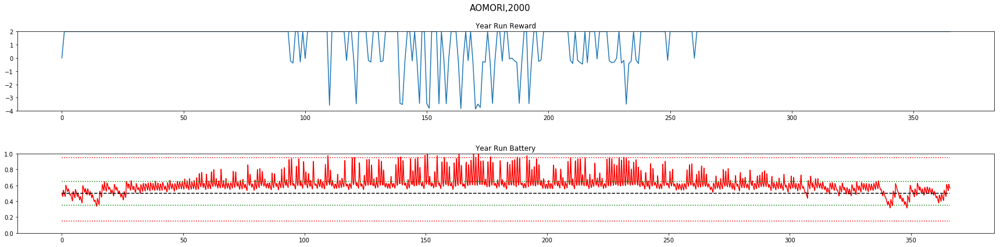

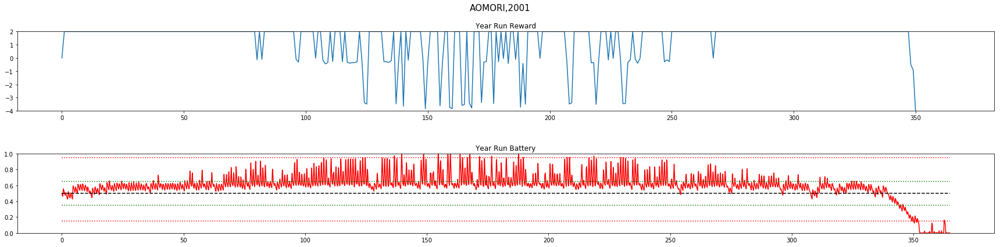

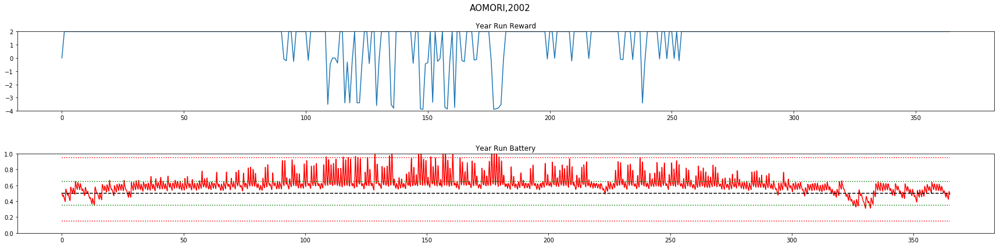

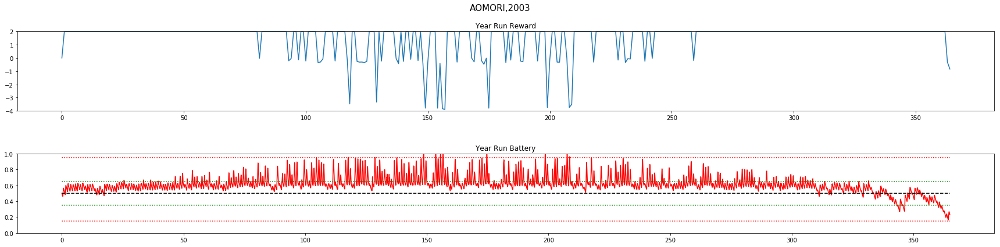

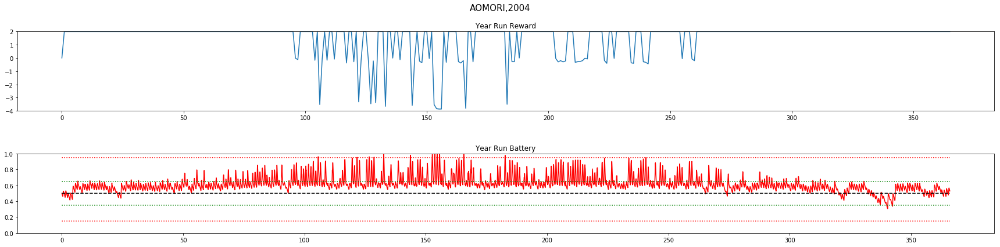

...

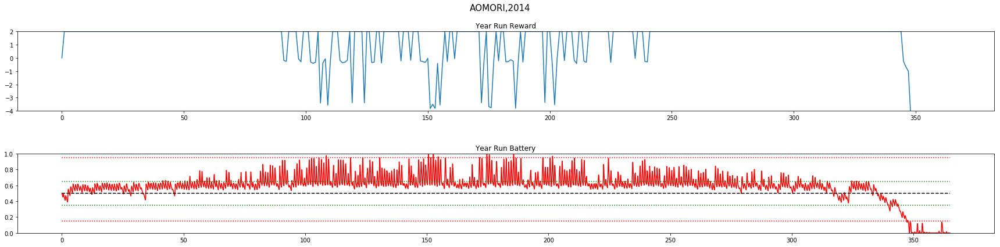

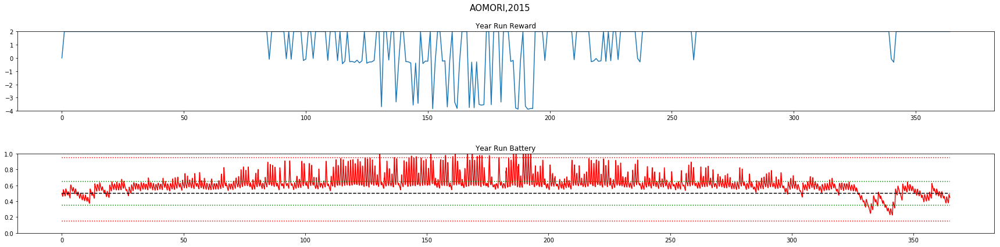

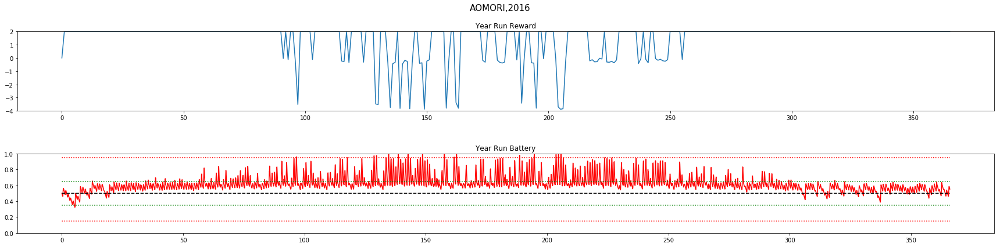

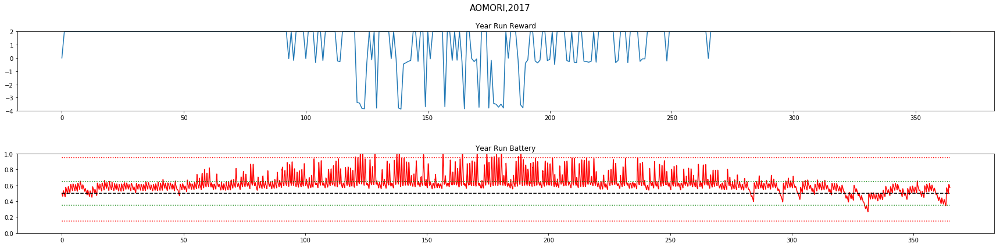

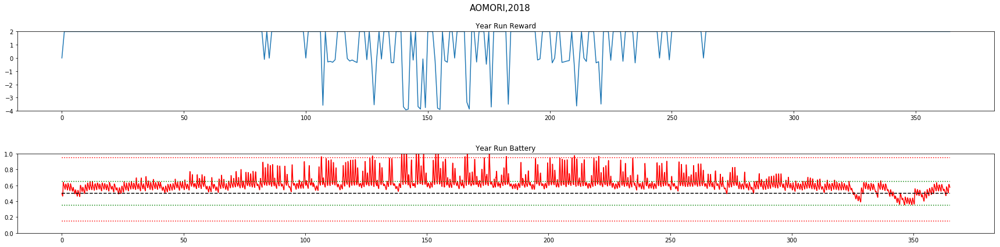



AOMORI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.42		17	 5
2001	 1.05		37	 235
2002	 1.48		19	 11
2003	 1.54		10	 9
2004	 1.53		12	 6
2005	 1.56		10	 8
2006	 1.56		11	 4
2007	 1.35		21	 11
2008	 1.39		19	 13
2009	 1.44		13	 4
2010	 1.51		13	 8
2011	 1.06		37	 282
2012	 1.35		22	 18
2013	 1.51		18	 13
2014	 1.11		32	 308
2015	 1.34		21	 14
2016	 1.42		15	 10
2017	 1.39		19	 11
2018	 1.47		16	 11

TOTAL Day Violations:   362.0
TOTAL Batt Violations:  981.0
************************************


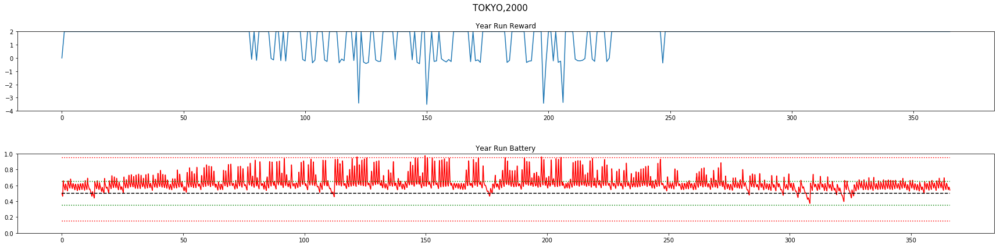

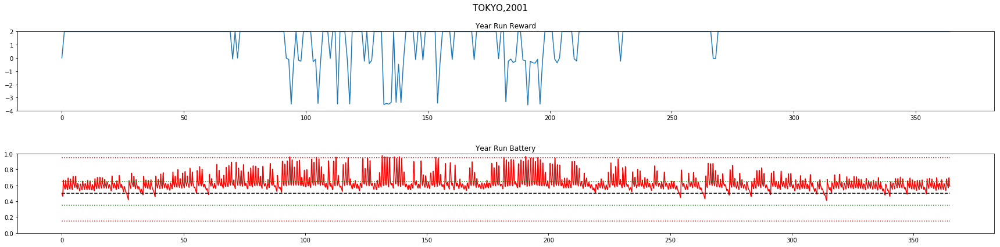

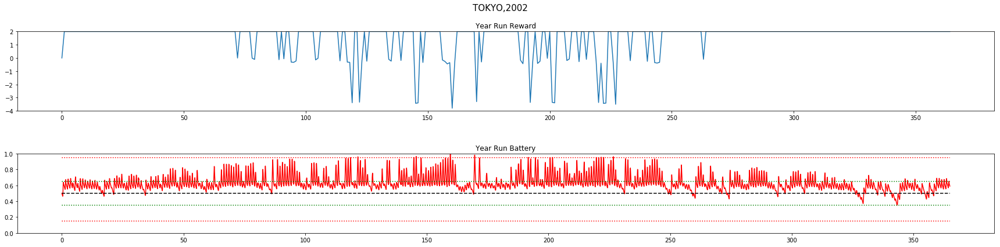

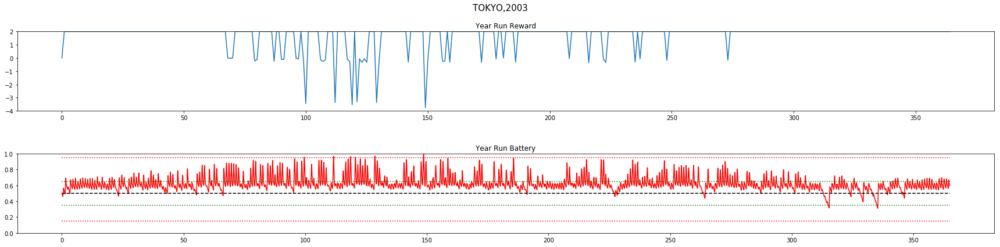

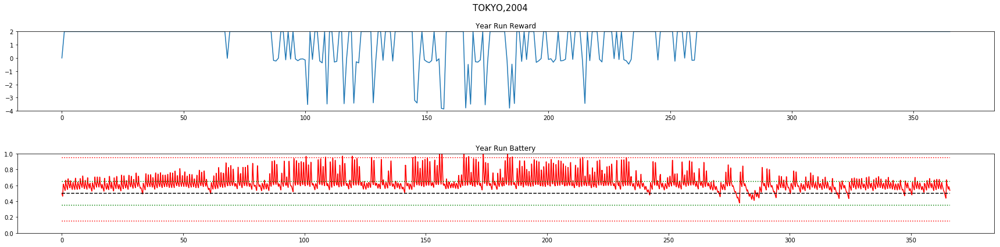

...

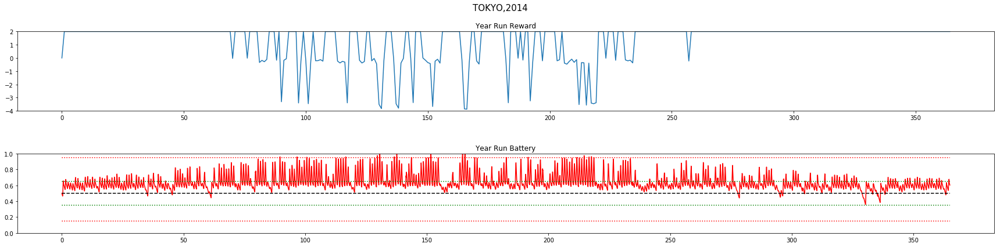

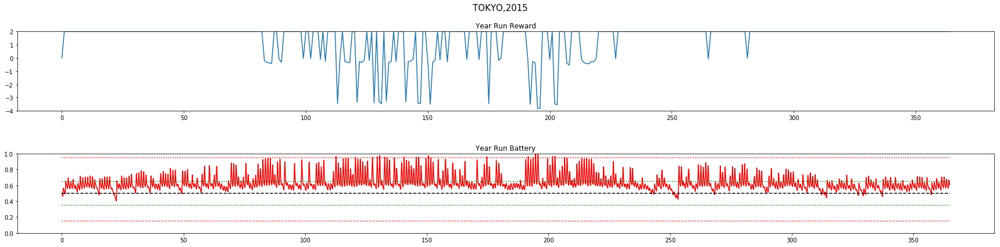

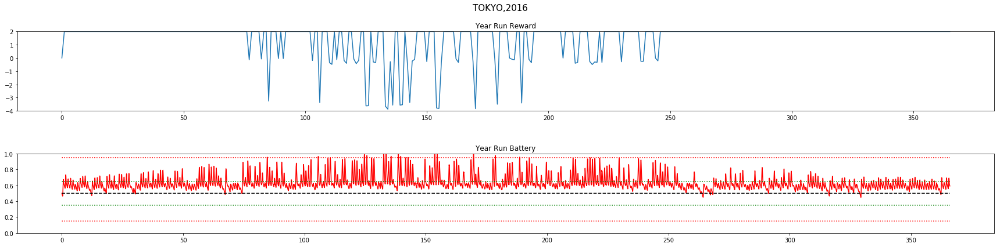

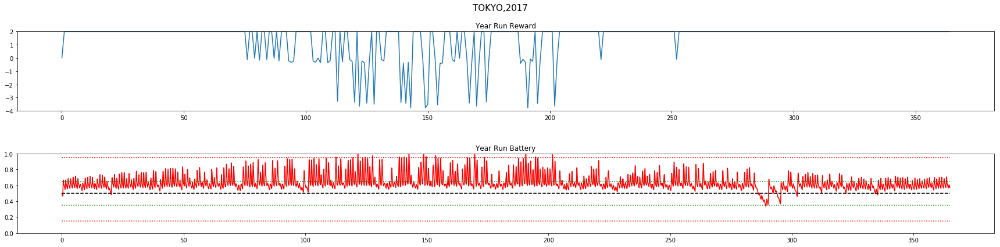

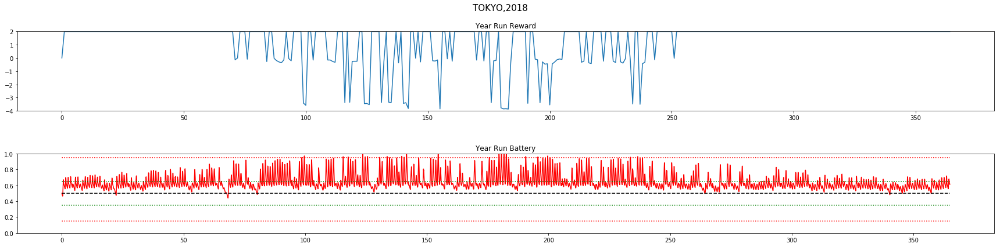



TOKYO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.59		4	 0
2001	 1.53		14	 0
2002	 1.53		13	 2
2003	 1.68		6	 1
2004	 1.38		15	 4
2005	 1.66		5	 1
2006	 1.71		5	 0
2007	 1.48		15	 4
2008	 1.64		7	 3
2009	 1.59		10	 0
2010	 1.41		18	 3
2011	 1.42		17	 5
2012	 1.38		17	 3
2013	 1.33		22	 8
2014	 1.31		19	 6
2015	 1.46		16	 2
2016	 1.5		15	 8
2017	 1.46		17	 6
2018	 1.27		24	 7

TOTAL Day Violations:   259.0
TOTAL Batt Violations:  63.0
************************************


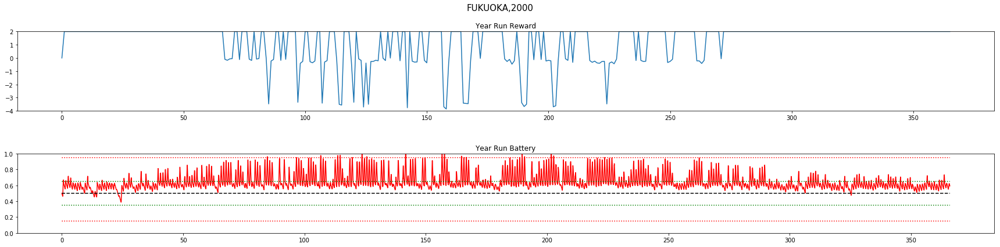

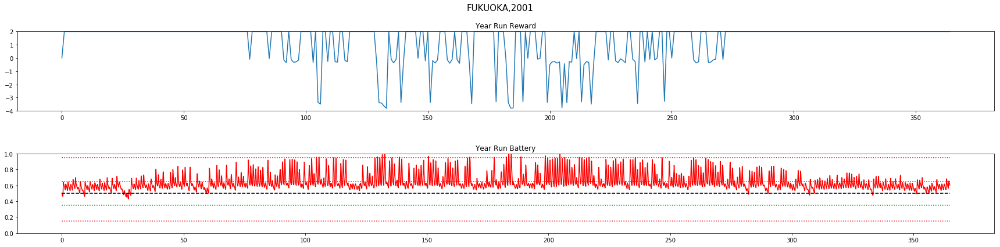

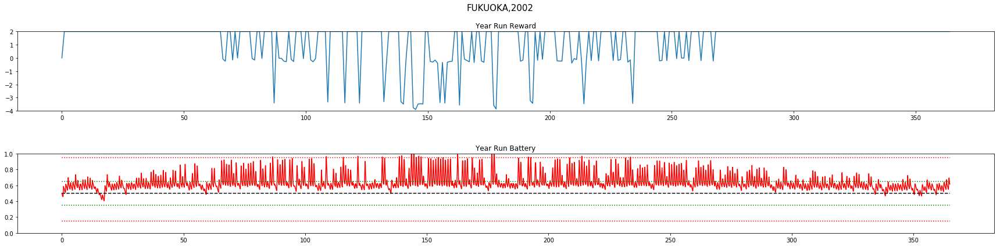

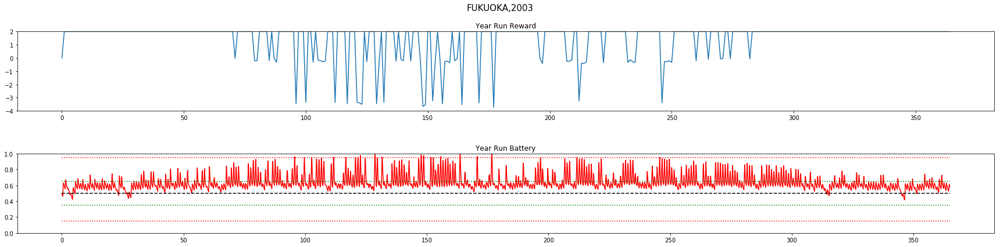

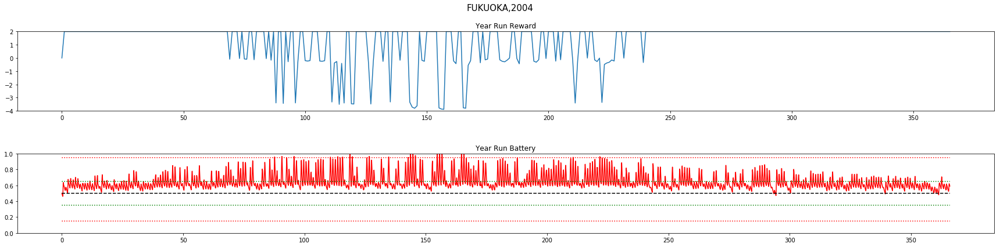

...

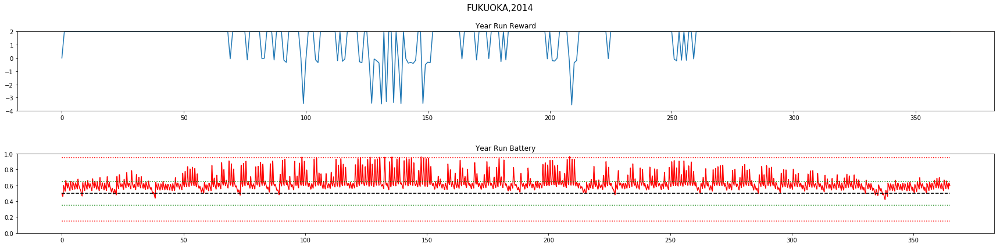

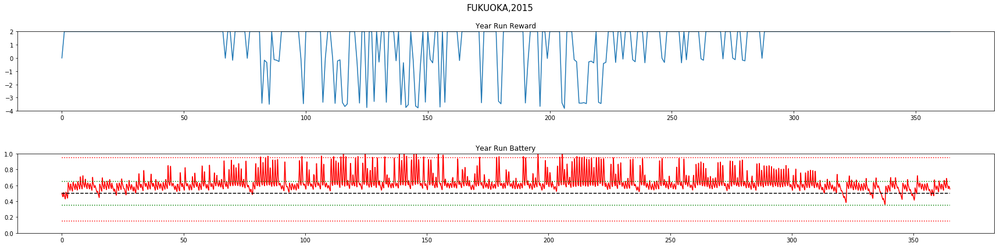

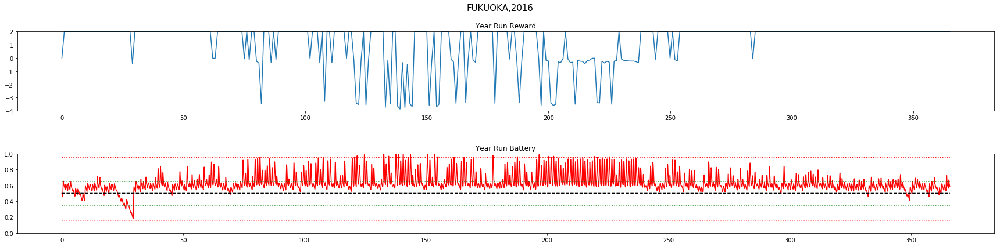

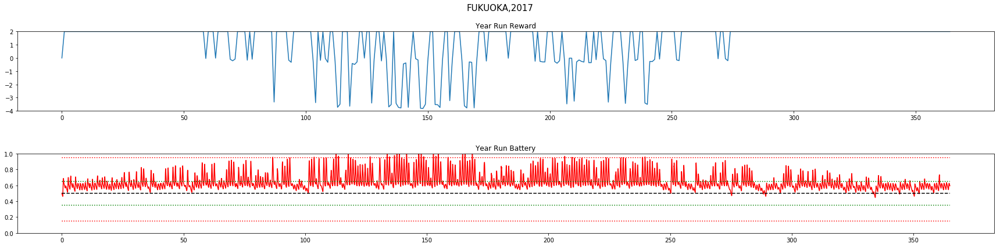

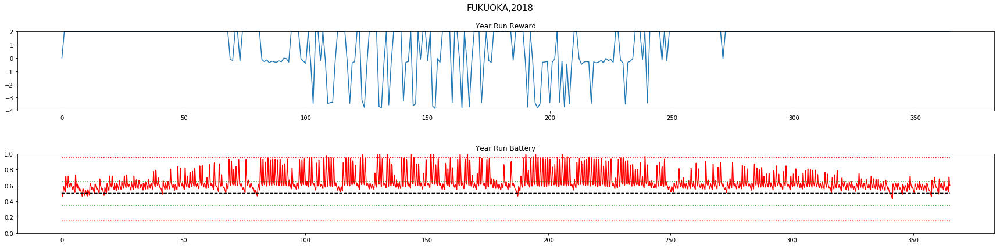



FUKUOKA
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.21		20	 4
2001	 1.26		21	 5
2002	 1.31		21	 7
2003	 1.43		18	 2
2004	 1.33		21	 9
2005	 1.25		22	 5
2006	 1.41		11	 0
2007	 1.37		12	 5
2008	 1.43		14	 2
2009	 1.29		22	 2
2010	 1.44		14	 5
2011	 1.57		5	 0
2012	 1.51		9	 0
2013	 1.4		12	 0
2014	 1.59		8	 0
2015	 1.21		33	 9
2016	 1.19		27	 12
2017	 1.16		28	 12
2018	 1.08		30	 16

TOTAL Day Violations:   348.0
TOTAL Batt Violations:  95.0
************************************


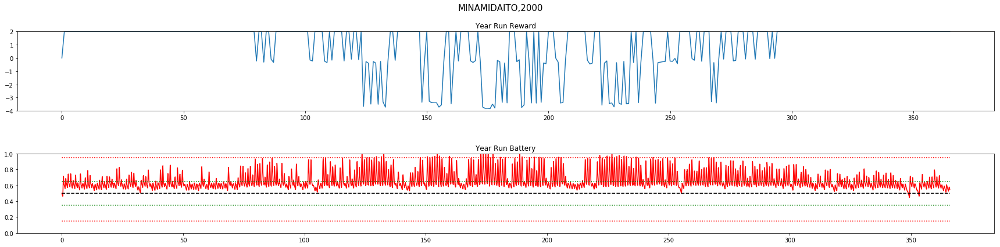

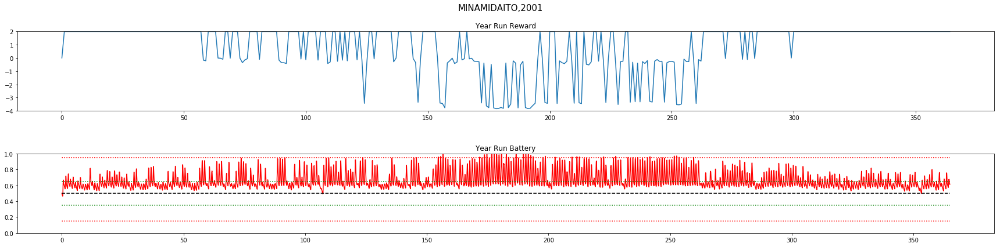

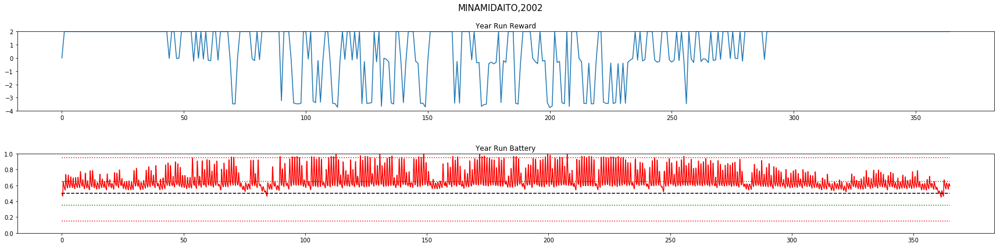

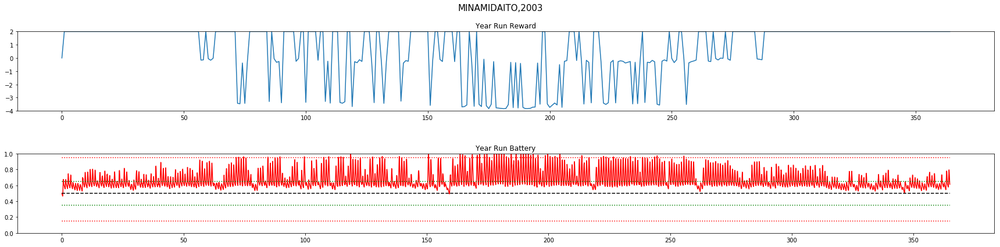

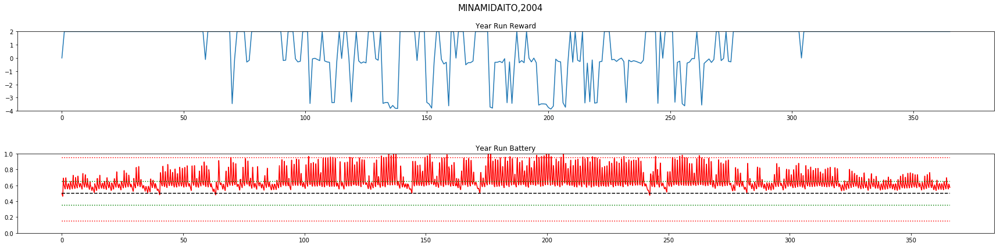

...

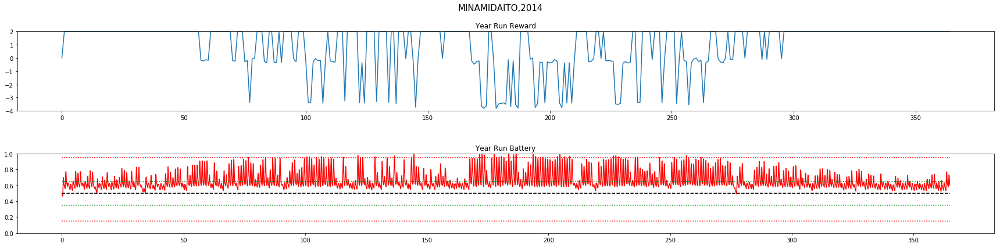

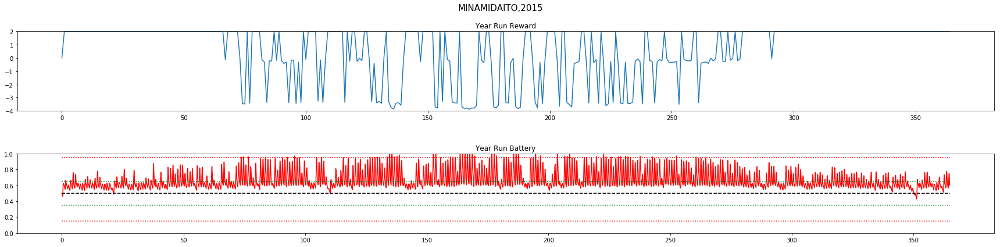

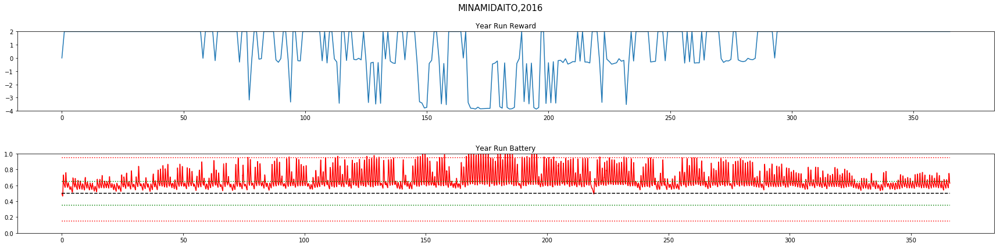

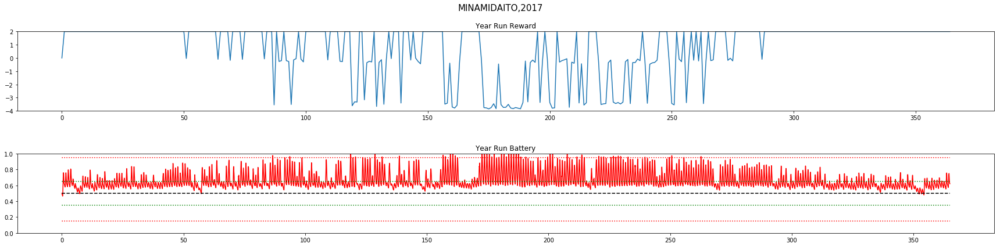

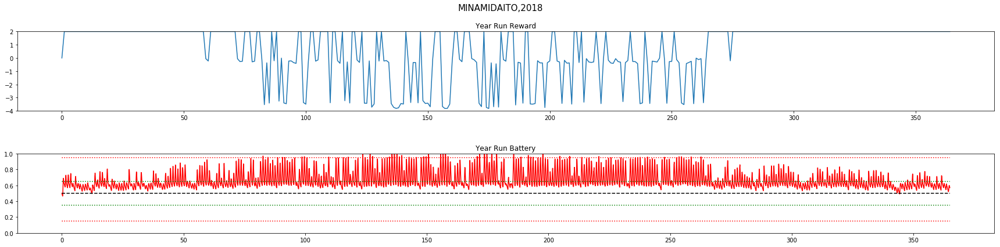



MINAMIDAITO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 0.98		40	 15
2001	 0.84		39	 17
2002	 0.73		50	 7
2003	 0.63		58	 30
2004	 0.85		39	 11
2005	 0.99		31	 6
2006	 0.78		47	 18
2007	 1.01		31	 13
2008	 1.01		30	 9
2009	 0.69		54	 10
2010	 0.97		36	 13
2011	 0.91		42	 15
2012	 1.08		35	 31
2013	 0.91		38	 11
2014	 0.91		38	 11
2015	 0.58		62	 20
2016	 0.84		38	 28
2017	 0.76		53	 26
2018	 0.61		55	 19

TOTAL Day Violations:   816.0
TOTAL Batt Violations:  310.0
************************************


In [22]:
#VALIDATION PHASE
print("***MEASURING PERFORMANCE OF THE MODEL***")
for LOCATION in ['wakkanai','aomori','tokyo','fukuoka','minamidaito']:
    results = np.empty(4)

    for YEAR in np.arange(2000,2019):
        capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
        capm.eno  = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
        capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

        s, r, day_end, year_end = capm.reset()
        yr_test_record = np.empty(4)

        while True:
            a = dqn.choose_greedy_action(stdize(s))
            yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action
            s_, r, day_end, year_end = capm.step(a)
            if year_end:
                break
            s = s_

        yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
        yr_test_reward_rec = yr_test_record[:,2]
        yr_test_reward_rec = yr_test_reward_rec[::24] #annual average reward
        results = np.vstack((results, [int(YEAR), np.mean(yr_test_reward_rec), int(capm.violation_counter), int(capm.batt_violations)]))

    ###########################################################################################
    ###########################################################################################
        #     Plot the reward and battery for the entire year run
        title = LOCATION.upper() + ',' + str(YEAR)
        NO_OF_DAYS = capm.eno.NO_OF_DAYS

        fig = plt.figure(figsize=(24,6))
        fig.suptitle(title, fontsize=15)

        ax1 = fig.add_subplot(211)
        ax1.plot(yr_test_reward_rec)
        ax1.set_title("\n\nYear Run Reward")
        ax1.set_ylim([-4,2])

        ax2 = fig.add_subplot(212)
        ax2.plot(yr_test_record[:,0],'r')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')

        ax2.set_title("\n\nYear Run Battery")
        ax2.set_ylim([0,1])
        plt.sca(ax2)
        plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
        fig.tight_layout()
        plt.show()
    ###########################################################################################
    ###########################################################################################
    results = np.delete(results,0,0)
    print("\n")
    print(LOCATION.upper())
    print('YEAR\tAVG_RWD\t\tVIOLATIONS')
    print('\t\t\tDAY\tBATT')

    for x in np.arange(0,results.shape[0]):
        print('{}\t {}\t\t{}\t {}'.format(int(results[x,0]), np.around(results[x,1],2), int(results[x,2]), int(results[x,-1])))

    print("\nTOTAL Day Violations:  ",np.sum(results[:, 2]))
    print("TOTAL Batt Violations: ",np.sum(results[:,-1]))
    print("************************************")

In [23]:
print('\nRun time: {}'.format(datetime.now() - tic))


Run time: 0:33:55.585630


In [24]:
LOCATION = 'tokyo'
YEAR = 2000

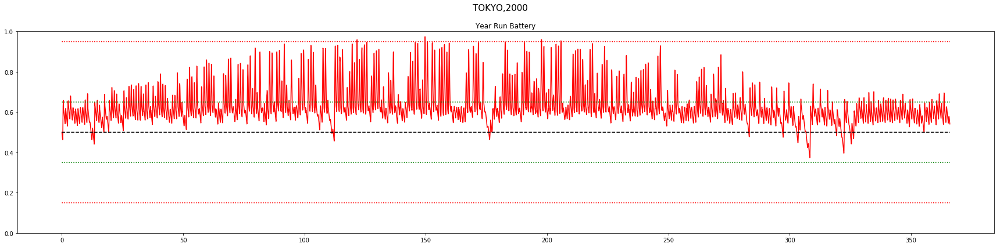

In [25]:
capm = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
capm.eno = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

s, r, day_end, year_end = capm.reset()
yr_test_record = np.empty(4)

while True:
    a = dqn.choose_greedy_action(stdize(s))

    #state = [batt, enp, henergy, fcast]
    yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action

    # take action
    s_, r, day_end, year_end = capm.step(a)

    if year_end:
        break

    s = s_

yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
yr_test_reward_rec = yr_test_record[:,2]
yr_test_reward_rec = yr_test_reward_rec[::24]

title = LOCATION.upper() + ',' + str(YEAR)
NO_OF_DAYS = capm.eno.NO_OF_DAYS

fig = plt.figure(figsize=(24,6))
fig.suptitle(title, fontsize=15)

#     ax1 = fig.add_subplot(211)
#     ax1.plot(yr_test_reward_rec)
#     ax1.set_title("\n\nYear Run Reward")
#     ax1.set_ylim([-3,3])

#Plot the reward and battery for the entire year run
ax2 = fig.add_subplot(111)
ax2.plot(yr_test_record[:,0],'r')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
ax2.set_title("\n\nYear Run Battery")
ax2.set_ylim([0,1])
plt.sca(ax2)
plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
fig.tight_layout()
plt.show()

In [26]:
DAY_START = 320
DAY_END   = 325

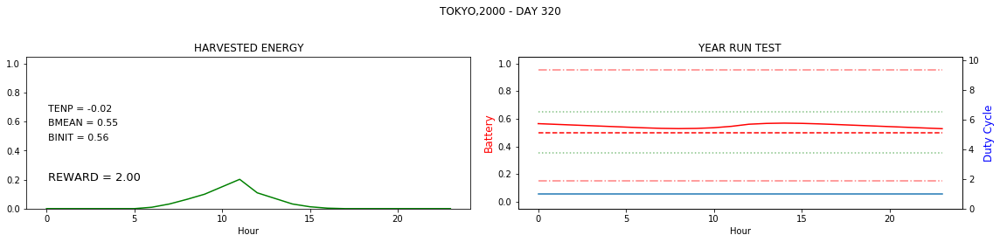

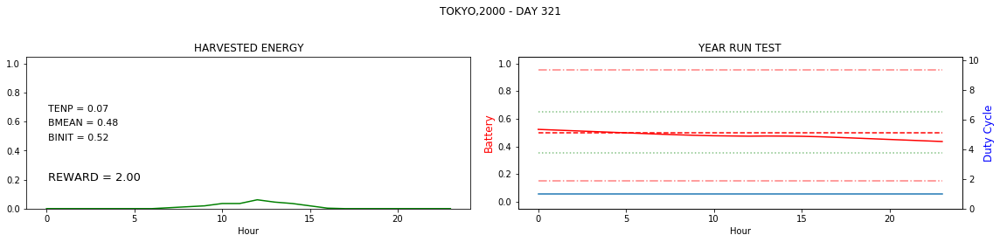

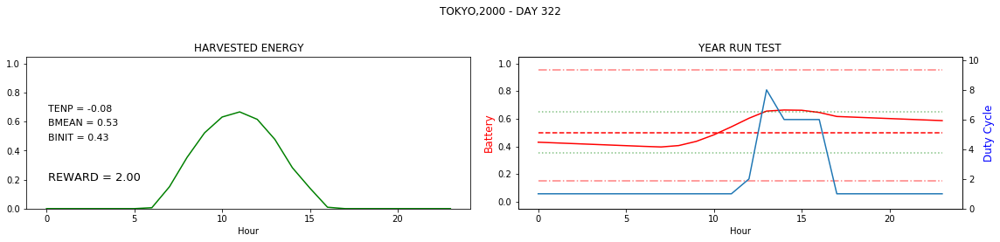

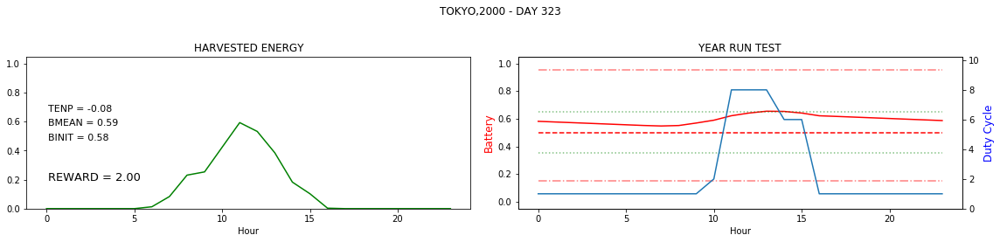

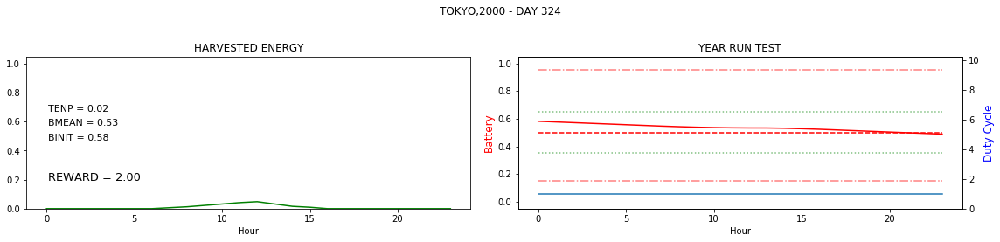

In [27]:
#Plot the reward and battery for the entire year run on a day by day basis
title = LOCATION.upper() + ',' + str(YEAR)
TIME_AXIS = np.arange(0,capm.eno.TIME_STEPS)
for DAY in range(DAY_START,DAY_END):
    START = DAY*24
    END = START+24

    daytitle = title + ' - DAY ' + str(DAY)
    fig = plt.figure(figsize=(16,4))
    st = fig.suptitle(daytitle)

    ax2 = fig.add_subplot(121)
    ax2.plot(yr_test_record[START:END,1],'g')
    ax2.set_title("HARVESTED ENERGY")
    ax2.set_xlabel("Hour")
    ax2.set_ylim([0,1.05])
    
    ax2.text(0.1, 0.6, "TENP = %.2f\n" %(capm.BOPT/capm.BMAX-yr_test_record[END,0]),fontsize=11, ha='left')
    ax2.text(0.1, 0.5, "BMEAN = %.2f\n" %(np.mean(yr_test_record[START:END,0])),fontsize=11, ha='left')
    ax2.text(0.1, 0.4, "BINIT = %.2f\n" %(yr_test_record[START,0]),fontsize=11, ha='left')
    if END < (capm.eno.NO_OF_DAYS*capm.eno.TIME_STEPS):
        ax2.text(0.1, 0.1, "REWARD = %.2f\n" %(yr_test_record[END,2]),fontsize=13, ha='left')
        
    #plot battery for year run
    ax1 = fig.add_subplot(122)
    ax1.plot(TIME_AXIS,              yr_test_record[START:END,0],'r')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BOPT/capm.BMAX, 'r--')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_LO/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_HI/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:',alpha=0.5)
    
    ax1.set_title("YEAR RUN TEST")
    ax1.set_xlabel("Hour")
    ax1.set_ylabel('Battery', color='r',fontsize=12)
    ax1.set_ylim([-0.05,1.05])

    #plot actions for year run
    ax1a = ax1.twinx()
    ax1a.plot(yr_test_record[START:END,3]+1)
    ax1a.set_ylim([0,N_ACTIONS])
    ax1a.set_ylabel('Duty Cycle', color='b',fontsize=12)
    ax1a.set_ylim([0,10.25])


    fig.tight_layout()
    st.set_y(0.95)
    fig.subplots_adjust(top=0.75)
    plt.show()